# Data Mining course : SNCB model prediction

The code below is linked to a project given in the course INFO-H423. The purpose of the lesson is to apply our new Machine Learning skills to analyse, classify and predict when a train could be stopped for maintenance.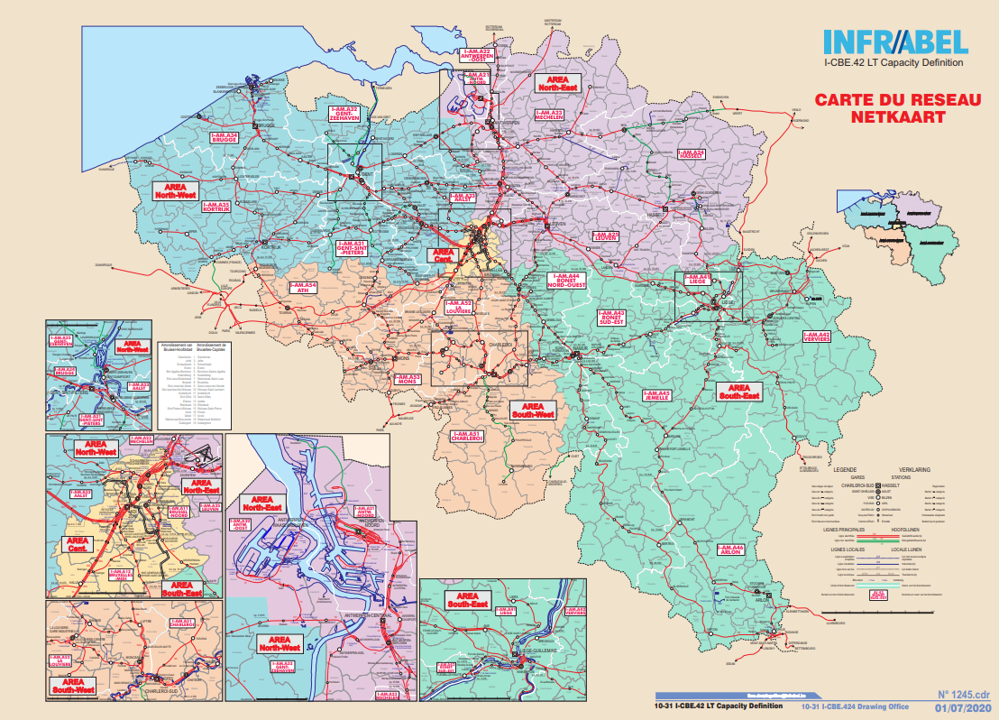 


# 1. Load data 

In [35]:
# general import of needed library
import pandas as pd
import numpy as np
import os
import glob
import statistics
import requests
from functools import reduce
from tabulate import tabulate
pd.set_option('display.max_colwidth', None)

In [36]:
df_merged = pd.read_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\AR41_DATA", sep = ';')
#df_merged['Row_number'] = df_merged.reset_index().index

df_merged = df_merged.rename(columns={"Unnamed: 0": "Row_number", "mapped_veh_id": "Mapped_veh_id"})
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
0,0,181.0,2023-08-01 03:44:12,50.769818,3.872114,27.0,23.0,255.0,238.0,794.0,801.0,83.0,81.0,76.0,77.0
1,1,143.0,2023-08-01 06:36:29,51.039993,3.693429,33.0,32.0,272.0,324.0,802.0,804.0,78.0,78.0,73.0,74.0
2,2,183.0,2023-08-24 06:53:54,50.742203,3.602035,31.0,33.0,234.0,182.0,799.0,802.0,82.0,82.0,85.0,87.0
3,3,177.0,2023-08-01 13:53:38,50.930914,5.327132,35.0,38.0,220.0,244.0,794.0,801.0,77.0,81.0,78.0,82.0
4,4,143.0,2023-08-24 07:02:30,51.180773,3.575259,41.0,34.0,227.0,282.0,806.0,800.0,85.0,78.0,82.0,79.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17679268,17679268,180.0,2023-05-28 19:28:59,50.919864,3.791125,40.0,36.0,238.0,238.0,800.0,797.0,86.0,86.0,90.0,92.0
17679269,17679269,180.0,2023-05-28 19:54:41,51.035243,3.710695,41.0,31.0,244.0,241.0,790.0,801.0,86.0,87.0,87.0,87.0
17679270,17679270,122.0,2023-05-28 20:23:20,51.015686,3.775316,52.0,42.0,3.0,3.0,0.0,0.0,78.0,82.0,80.0,82.0
17679271,17679271,177.0,2023-05-28 20:46:00,51.189586,5.109380,27.0,38.0,417.0,469.0,1441.0,1454.0,77.0,78.0,76.0,80.0


In [39]:
# Set float format to suppress scientific notation
pd.options.display.float_format = "{:.2f}".format

# Print the descriptive statistics
df_merged.describe()

,Row_number,Mapped_veh_id,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
count,17679273.00,17679273.00,17679273.00,17679273.00,17679273.00,17666547.00,17679273.00,17666547.00,17679273.00,17666547.00,17679273.00,17666547.00,17679273.00,17666547.00
mean,8839636.00,150.84,50.88,4.23,32.02,32.33,263.61,270.69,912.25,907.96,76.93,76.14,76.55,76.16
std,5103566.66,26.94,0.31,0.60,328.00,348.00,115.24,116.12,383.31,388.47,13.65,14.53,14.50,15.35
min,0.00,102.00,48.30,0.18,0.00,0.00,0.00,0.00,0.00,0.00,-15.00,-17.00,-128.00,0.00
25%,4419818.00,128.00,50.77,3.72,22.00,22.00,203.00,210.00,797.00,797.00,77.00,76.00,74.00,74.00
50%,8839636.00,151.00,51.00,3.87,32.00,33.00,238.00,248.00,801.00,801.00,81.00,81.00,81.00,81.00
75%,13259454.00,174.00,51.09,4.54,40.00,39.00,320.00,331.00,812.00,811.00,84.00,84.00,85.00,85.00
max,17679272.00,197.00,52.86,8.05,65535.00,65535.00,690.00,690.00,2309.00,9732.00,109.00,119.00,127.00,117.00


# Quatre règles à implémenter
1. Remove the train that have less than 20' elpased between rows ==> define a distribution method for this
2. If a  train has more than 40% of 0 value, remove the lines
3. If a train has in his columns more than 20% of NaN value, remove them
4. Calculate the approximate result for the NaN values

## Calculate first rule

In [50]:
# Create columns and specify types
df_merged['Dates'] = pd.to_datetime(df_merged['timestamps_UTC']).dt.date
df_merged['Dates'] = df_merged['Dates'].astype("string")
df_merged['Time'] = pd.to_datetime(df_merged['timestamps_UTC']).dt.time

# Select columns
df_merged = df_merged[['Row_number', 'Mapped_veh_id', 'timestamps_UTC','Dates', 'Time', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2']]

# Sort dataframe
df_merged = df_merged.sort_values(['Mapped_veh_id','Dates', 'Time'])

# Show dataframe
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
5493376,5493376,102.0,2023-01-23 07:25:08,2023-01-23,07:25:08,51.017864,3.769079,17.0,18.0,210.0,210.0,858.0,839.0,78.0,80.0,71.0,79.0
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23,07:25:16,51.017875,3.769046,17.0,20.0,200.0,200.0,801.0,804.0,79.0,80.0,76.0,79.0
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,207.0,803.0,808.0,80.0,81.0,79.0,81.0
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23,07:25:41,51.016916,3.771036,19.0,20.0,196.0,203.0,801.0,803.0,80.0,81.0,79.0,81.0
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,203.0,795.0,807.0,80.0,82.0,79.0,79.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13,17:33:03,50.402693,4.450111,37.0,40.0,220.0,258.0,803.0,803.0,81.0,79.0,77.0,81.0
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,307.0,843.0,941.0,80.0,78.0,77.0,80.0
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13,17:34:03,50.401830,4.452217,37.0,38.0,224.0,307.0,841.0,932.0,80.0,78.0,77.0,80.0
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13,17:34:58,50.401057,4.455388,36.0,38.0,207.0,244.0,800.0,803.0,81.0,80.0,77.0,82.0


In [51]:
# lAG value for lattitude
df_merged["prev_lat"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["lat"].transform(pd.Series.shift, fill_value=np.nan)

# lAG value for longitude
df_merged["prev_lon"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["lon"].transform(pd.Series.shift, fill_value=np.nan)

# Lag value for time
df_merged["prev_time"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["Time"].transform(pd.Series.shift, fill_value=np.nan)

# Lag value for timestamps_UTC
df_merged["prev_timestamps_UTC"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["timestamps_UTC"].transform(pd.Series.shift, fill_value=np.nan)

# Show the results
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,...,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,prev_lat,prev_lon,prev_time,prev_timestamps_UTC
5493376,5493376,102.0,2023-01-23 07:25:08,2023-01-23,07:25:08,51.017864,3.769079,17.0,18.0,210.0,...,858.0,839.0,78.0,80.0,71.0,79.0,NaN,NaN,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23,07:25:16,51.017875,3.769046,17.0,20.0,200.0,...,801.0,804.0,79.0,80.0,76.0,79.0,51.017864,3.769079,07:25:08,2023-01-23 07:25:08
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,...,803.0,808.0,80.0,81.0,79.0,81.0,51.017875,3.769046,07:25:16,2023-01-23 07:25:16
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23,07:25:41,51.016916,3.771036,19.0,20.0,196.0,...,801.0,803.0,80.0,81.0,79.0,81.0,51.017208,3.770179,07:25:37,2023-01-23 07:25:37
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,...,795.0,807.0,80.0,82.0,79.0,79.0,51.016916,3.771036,07:25:41,2023-01-23 07:25:41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13,17:33:03,50.402693,4.450111,37.0,40.0,220.0,...,803.0,803.0,81.0,79.0,77.0,81.0,50.402628,4.450241,17:32:58,2023-09-13 17:32:58
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,...,843.0,941.0,80.0,78.0,77.0,80.0,50.402693,4.450111,17:33:03,2023-09-13 17:33:03
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13,17:34:03,50.401830,4.452217,37.0,38.0,224.0,...,841.0,932.0,80.0,78.0,77.0,80.0,50.401657,4.452693,17:33:58,2023-09-13 17:33:58
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13,17:34:58,50.401057,4.455388,36.0,38.0,207.0,...,800.0,803.0,81.0,80.0,77.0,82.0,50.401830,4.452217,17:34:03,2023-09-13 17:34:03


In [67]:
df_merged.columns

Index(['Row_number', 'Mapped_veh_id', 'timestamps_UTC', 'Dates', 'Time', 'lat',
       'lon', 'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'prev_lat',
       'prev_lon', 'prev_time', 'prev_timestamps_UTC', 'time_elapsed'],
      dtype='object')

# Calculate the median for the drop

In [17]:
import matplotlib.pyplot as plt
df_merged["time_elapsed_median"] = df_merged["time_elapsed"].dropna()
median = df_merged["time_elapsed_median"].median()
print(median)

50.0


In [52]:
# Convert timestamps to datetime
df_merged['timestamps_UTC'] = pd.to_datetime(df_merged['timestamps_UTC'])
df_merged['prev_timestamps_UTC'] = pd.to_datetime(df_merged['prev_timestamps_UTC'])

# Calculate time elapsed in seconds
df_merged['time_elapsed'] = (df_merged['timestamps_UTC'] - df_merged['prev_timestamps_UTC']).dt.total_seconds()

# Remove the rows for which the time_elapsed is less than 20 sec
df_merged = df_merged[df_merged["time_elapsed"] >= 20]
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,...,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,prev_lat,prev_lon,prev_time,prev_timestamps_UTC,time_elapsed
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,...,808.0,80.0,81.0,79.0,81.0,51.017875,3.769046,07:25:16,2023-01-23 07:25:16,21.0
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,...,807.0,80.0,82.0,79.0,79.0,51.016916,3.771036,07:25:41,2023-01-23 07:25:41,29.0
3531257,3531257,102.0,2023-01-23 07:27:09,2023-01-23,07:27:09,51.015750,3.774149,20.0,10.5,65.0,...,120.0,78.0,81.0,78.0,79.5,51.016234,3.772791,07:26:11,2023-01-23 07:26:11,58.0
13864974,13864974,102.0,2023-01-23 07:27:40,2023-01-23,07:27:40,51.015752,3.774144,23.0,26.0,0.0,...,0.0,78.0,80.0,75.0,79.0,51.015514,3.774717,07:27:12,2023-01-23 07:27:12,28.0
13848053,13848053,102.0,2023-01-23 07:28:10,2023-01-23,07:28:10,51.015741,3.774132,28.0,31.0,0.0,...,0.0,77.0,80.0,75.0,77.0,51.015504,3.774721,07:27:42,2023-01-23 07:27:42,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17133047,17133047,197.0,2023-09-13 17:30:58,2023-09-13,17:30:58,50.404185,4.440712,38.0,41.0,217.0,...,793.0,80.0,78.0,81.0,82.0,50.404209,4.438938,17:30:07,2023-09-13 17:30:07,51.0
13595879,13595879,197.0,2023-09-13 17:31:58,2023-09-13,17:31:58,50.403728,4.445765,38.0,40.0,217.0,...,800.0,80.0,78.0,79.0,83.0,50.403974,4.440646,17:31:07,2023-09-13 17:31:07,51.0
2002669,2002669,197.0,2023-09-13 17:32:58,2023-09-13,17:32:58,50.402628,4.450241,37.0,40.0,217.0,...,799.0,81.0,79.0,77.0,81.0,50.403646,4.445520,17:32:04,2023-09-13 17:32:04,54.0
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,...,941.0,80.0,78.0,77.0,80.0,50.402693,4.450111,17:33:03,2023-09-13 17:33:03,55.0


# Security drop on 0 value with more than 40%

In [59]:
# Group the DataFrame by train ID and date
grouped_df = df_merged.groupby(["Mapped_veh_id", "Dates"])

# Calculate the percentage of zeros for each column
for group in grouped_df:
    # Calculate the percentage of zeros for each column
    percentage_of_zero_values = (group[1] == 0).count()

    # Drop rows with more than 20% zeros
    for column, percentage in percentage_of_zero_values.items():
        if percentage > 0.4:
            group[1].drop(columns=[column], inplace=True)
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,...,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,prev_lat,prev_lon,prev_time,prev_timestamps_UTC,time_elapsed
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,...,808.0,80.0,81.0,79.0,81.0,51.017875,3.769046,07:25:16,2023-01-23 07:25:16,21.0
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,...,807.0,80.0,82.0,79.0,79.0,51.016916,3.771036,07:25:41,2023-01-23 07:25:41,29.0
3531257,3531257,102.0,2023-01-23 07:27:09,2023-01-23,07:27:09,51.015750,3.774149,20.0,10.5,65.0,...,120.0,78.0,81.0,78.0,79.5,51.016234,3.772791,07:26:11,2023-01-23 07:26:11,58.0
13864974,13864974,102.0,2023-01-23 07:27:40,2023-01-23,07:27:40,51.015752,3.774144,23.0,26.0,0.0,...,0.0,78.0,80.0,75.0,79.0,51.015514,3.774717,07:27:12,2023-01-23 07:27:12,28.0
13848053,13848053,102.0,2023-01-23 07:28:10,2023-01-23,07:28:10,51.015741,3.774132,28.0,31.0,0.0,...,0.0,77.0,80.0,75.0,77.0,51.015504,3.774721,07:27:42,2023-01-23 07:27:42,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17133047,17133047,197.0,2023-09-13 17:30:58,2023-09-13,17:30:58,50.404185,4.440712,38.0,41.0,217.0,...,793.0,80.0,78.0,81.0,82.0,50.404209,4.438938,17:30:07,2023-09-13 17:30:07,51.0
13595879,13595879,197.0,2023-09-13 17:31:58,2023-09-13,17:31:58,50.403728,4.445765,38.0,40.0,217.0,...,800.0,80.0,78.0,79.0,83.0,50.403974,4.440646,17:31:07,2023-09-13 17:31:07,51.0
2002669,2002669,197.0,2023-09-13 17:32:58,2023-09-13,17:32:58,50.402628,4.450241,37.0,40.0,217.0,...,799.0,81.0,79.0,77.0,81.0,50.403646,4.445520,17:32:04,2023-09-13 17:32:04,54.0
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,...,941.0,80.0,78.0,77.0,80.0,50.402693,4.450111,17:33:03,2023-09-13 17:33:03,55.0


## Security drop on NaN value with more than 20%

In [60]:
# Security drop if the dataset has column with more than 20% NaN values.
df = df_merged

# Group the DataFrame by train ID and date
grouped_df = df_merged.groupby(["Mapped_veh_id", "Dates"])

# Calculate the percentage of missing values for each column
for group in grouped_df:
    # Calculate the percentage of missing values for each column
    percentage_of_missing_values = group[1].isnull().count()

    # Drop rows with more than 20% missing values
    for column, percentage in percentage_of_missing_values.items():
        if percentage > 0.2:
            group[1].drop(columns=[column], inplace=True)
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,...,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,prev_lat,prev_lon,prev_time,prev_timestamps_UTC,time_elapsed
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,...,808.0,80.0,81.0,79.0,81.0,51.017875,3.769046,07:25:16,2023-01-23 07:25:16,21.0
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,...,807.0,80.0,82.0,79.0,79.0,51.016916,3.771036,07:25:41,2023-01-23 07:25:41,29.0
3531257,3531257,102.0,2023-01-23 07:27:09,2023-01-23,07:27:09,51.015750,3.774149,20.0,10.5,65.0,...,120.0,78.0,81.0,78.0,79.5,51.016234,3.772791,07:26:11,2023-01-23 07:26:11,58.0
13864974,13864974,102.0,2023-01-23 07:27:40,2023-01-23,07:27:40,51.015752,3.774144,23.0,26.0,0.0,...,0.0,78.0,80.0,75.0,79.0,51.015514,3.774717,07:27:12,2023-01-23 07:27:12,28.0
13848053,13848053,102.0,2023-01-23 07:28:10,2023-01-23,07:28:10,51.015741,3.774132,28.0,31.0,0.0,...,0.0,77.0,80.0,75.0,77.0,51.015504,3.774721,07:27:42,2023-01-23 07:27:42,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17133047,17133047,197.0,2023-09-13 17:30:58,2023-09-13,17:30:58,50.404185,4.440712,38.0,41.0,217.0,...,793.0,80.0,78.0,81.0,82.0,50.404209,4.438938,17:30:07,2023-09-13 17:30:07,51.0
13595879,13595879,197.0,2023-09-13 17:31:58,2023-09-13,17:31:58,50.403728,4.445765,38.0,40.0,217.0,...,800.0,80.0,78.0,79.0,83.0,50.403974,4.440646,17:31:07,2023-09-13 17:31:07,51.0
2002669,2002669,197.0,2023-09-13 17:32:58,2023-09-13,17:32:58,50.402628,4.450241,37.0,40.0,217.0,...,799.0,81.0,79.0,77.0,81.0,50.403646,4.445520,17:32:04,2023-09-13 17:32:04,54.0
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,...,941.0,80.0,78.0,77.0,80.0,50.402693,4.450111,17:33:03,2023-09-13 17:33:03,55.0


In [66]:
# Identify NaN values 
def identify_nan_columns(dataframe):
    nan_columns = []
    for column in dataframe.columns:
        if dataframe[column].isnull().any():
            nan_columns.append(column)

    return nan_columns

identify_nan_columns(df_merged)

[]

In [65]:
# Identify columns with NaN values
nan_columns = identify_nan_columns(df_merged)

# Create interpolation functions for all columns
for column in nan_columns:
    interpolator = interp1d(df_merged[column].dropna().index, df_merged[column].dropna())

    # Impute missing values using interpolation
    for index in df_merged.index:
        if np.isnan(df_merged.loc[index, column]):
            df_merged.loc[index, column] = interpolator(index)
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,...,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,prev_lat,prev_lon,prev_time,prev_timestamps_UTC,time_elapsed
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,...,808.0,80.0,81.0,79.0,81.0,51.017875,3.769046,07:25:16,2023-01-23 07:25:16,21.0
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,...,807.0,80.0,82.0,79.0,79.0,51.016916,3.771036,07:25:41,2023-01-23 07:25:41,29.0
3531257,3531257,102.0,2023-01-23 07:27:09,2023-01-23,07:27:09,51.015750,3.774149,20.0,10.5,65.0,...,120.0,78.0,81.0,78.0,79.5,51.016234,3.772791,07:26:11,2023-01-23 07:26:11,58.0
13864974,13864974,102.0,2023-01-23 07:27:40,2023-01-23,07:27:40,51.015752,3.774144,23.0,26.0,0.0,...,0.0,78.0,80.0,75.0,79.0,51.015514,3.774717,07:27:12,2023-01-23 07:27:12,28.0
13848053,13848053,102.0,2023-01-23 07:28:10,2023-01-23,07:28:10,51.015741,3.774132,28.0,31.0,0.0,...,0.0,77.0,80.0,75.0,77.0,51.015504,3.774721,07:27:42,2023-01-23 07:27:42,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17133047,17133047,197.0,2023-09-13 17:30:58,2023-09-13,17:30:58,50.404185,4.440712,38.0,41.0,217.0,...,793.0,80.0,78.0,81.0,82.0,50.404209,4.438938,17:30:07,2023-09-13 17:30:07,51.0
13595879,13595879,197.0,2023-09-13 17:31:58,2023-09-13,17:31:58,50.403728,4.445765,38.0,40.0,217.0,...,800.0,80.0,78.0,79.0,83.0,50.403974,4.440646,17:31:07,2023-09-13 17:31:07,51.0
2002669,2002669,197.0,2023-09-13 17:32:58,2023-09-13,17:32:58,50.402628,4.450241,37.0,40.0,217.0,...,799.0,81.0,79.0,77.0,81.0,50.403646,4.445520,17:32:04,2023-09-13 17:32:04,54.0
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,...,941.0,80.0,78.0,77.0,80.0,50.402693,4.450111,17:33:03,2023-09-13 17:33:03,55.0


In [50]:
df = df_merged

# Create a new level named "timestamps_UTC" in the index
df.set_index(["timestamps_UTC"], inplace=True)
# Groupez les données par nom de véhicule et par jour
grouped_df = df.groupby(["Mapped_veh_id", pd.Grouper(level="timestamps_UTC", freq="D")])

# Pour chaque groupe, calculez le pourcentage de valeurs manquantes pour chaque colonne
for group in grouped_df:
    # Calculez le pourcentage de valeurs manquantes pour chaque colonne
    percentage_of_missing_values = group[1].isnull().mean()
    # Créez un tableau avec le nom de la colonne et le pourcentage de valeurs manquantes
    result = pd.DataFrame({"Column": group[1].columns, "Percentage of missing values": percentage_of_missing_values})
    # Imprimez le tableau
    print(result)

                                  Column  Percentage of missing values
Row_number                    Row_number                           0.0
Mapped_veh_id              Mapped_veh_id                           0.0
Dates                              Dates                           0.0
Time                                Time                           0.0
lat                                  lat                           0.0
lon                                  lon                           0.0
RS_E_InAirTemp_PC1    RS_E_InAirTemp_PC1                           0.0
RS_E_InAirTemp_PC2    RS_E_InAirTemp_PC2                           0.0
RS_E_OilPress_PC1      RS_E_OilPress_PC1                           0.0
RS_E_OilPress_PC2      RS_E_OilPress_PC2                           0.0
RS_E_RPM_PC1                RS_E_RPM_PC1                           0.0
RS_E_RPM_PC2                RS_E_RPM_PC2                           0.0
RS_E_WatTemp_PC1        RS_E_WatTemp_PC1                           0.0
RS_E_W

In [4]:
# read the file from there
df_xy = pd.read_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\merged_direction_smoothslope_smoothelevation_smoothkph_xy_dist_full_dataset.csv", sep = ';')

# Select columns
df_xy = df_xy[['att1', 'mapped_veh_id', 'timestamps_UTC', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle']]

# Rename columns
df_xy = df_xy.rename(columns={"att1": "Row_number", "mapped_veh_id": "Mapped_veh_id"})

# Show the DF
df_xy

,Row_number,Mapped_veh_id,timestamps_UTC,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,...,RS_T_OilTemp_PC2,x,y,distance,speed_kph,etopo1_elevation,slope,x-8,y-8,angle
0,0,181.0,2023-08-01 03:44:12,50.769818,3.872114,27.0,23.0,255.0,238.0,794.0,...,77.0,114967.003929,162264.108892,49.524119,20.736387,30.0,0.000000,114965.519257,162263.618225,71.711861
1,1,143.0,2023-08-01 06:36:29,51.039993,3.693429,33.0,32.0,272.0,324.0,802.0,...,74.0,102635.784313,192417.230242,47.822647,12.223079,6.0,0.000000,102632.954012,192414.508036,46.115281
2,2,183.0,2023-08-24 06:53:54,50.742203,3.602035,31.0,33.0,234.0,182.0,799.0,...,87.0,95884.316392,159354.254143,41.991443,31.675001,38.0,-0.000552,95884.882226,159352.312666,343.751468
3,3,177.0,2023-08-01 13:53:38,50.930914,5.327132,35.0,38.0,220.0,244.0,794.0,...,82.0,217371.804599,180503.158752,45.748298,40.815730,37.0,0.005045,216571.609019,180811.644716,111.082310
4,4,143.0,2023-08-24 07:02:30,51.180773,3.575259,41.0,34.0,227.0,282.0,806.0,...,79.0,94515.418096,208159.920637,44.023801,33.623397,6.0,0.000000,94515.458229,208163.024343,180.740834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17679268,17679268,180.0,2023-05-28 19:28:59,50.919864,3.791125,40.0,36.0,238.0,238.0,800.0,...,92.0,109383.755416,178996.103713,45.337188,41.622837,44.4,-0.041716,110520.993886,176510.278812,335.416409
17679269,17679269,180.0,2023-05-28 19:54:41,51.035243,3.710695,41.0,31.0,244.0,241.0,790.0,...,87.0,103842.064033,191877.886677,0.147721,27.936173,10.0,-0.002464,105731.605895,191572.336594,279.185553
17679270,17679270,122.0,2023-05-28 20:23:20,51.015686,3.775316,52.0,42.0,3.0,3.0,0.0,...,82.0,108357.262690,189664.223867,43.166744,11.334497,11.0,-0.000139,107918.568805,189900.535300,118.310034
17679271,17679271,177.0,2023-05-28 20:46:00,51.189586,5.109380,27.0,38.0,417.0,469.0,1441.0,...,80.0,201777.661576,209103.271071,43.398965,54.969777,27.0,0.000366,201735.980511,209093.197814,76.413577


In [6]:
# Load data
df1 = pd.read_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\temp_weather", dtype={'Columns (0)': int}, low_memory=False)

# Create new column with index
df1['Row_number'] = df1.reset_index().index

# Order the columns
df1 = df1[['Row_number','station', 'round_time', 'temperature', 'rel_hum', 'precipitation',
       'pressure']]
# Show the result
df1

,Row_number,station,round_time,temperature,rel_hum,precipitation,pressure
0,0,06428,2023-08-01 04:00:00,15.3,91.0,0.0,1001.0
1,1,06434,2023-08-01 07:00:00,16.6,87.0,0.0,1001.9
2,2,06428,2023-08-24 07:00:00,19.4,85.0,0.0,1014.3
3,3,06477,2023-08-01 14:00:00,19.4,64.0,0.4,1003.2
4,4,06431,2023-08-24 07:00:00,20.3,86.0,NaN,1014.9
...,...,...,...,...,...,...,...
17679268,17679268,06428,2023-05-28 19:00:00,17.6,64.0,0.0,1020.5
17679269,17679269,06434,2023-05-28 20:00:00,16.2,63.0,0.0,1021.7
17679270,17679270,06434,2023-05-28 20:00:00,16.2,63.0,0.0,1021.7
17679271,17679271,06464,2023-05-28 21:00:00,16.6,67.0,0.0,1022.0


# 2. Merged data sources

In [7]:
df_merged = pd.merge(df_merged, df_weather, on='Row_number')
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,...,slope,x-8,y-8,angle,station,round_time,temperature,rel_hum,precipitation,pressure
0,0,181.0,2023-08-01 03:44:12,50.769818,3.872114,27.0,23.0,255.0,238.0,794.0,...,0.000000,114965.519257,162263.618225,71.711861,06428,2023-08-01 04:00:00,15.3,91.0,0.0,1001.0
1,1,143.0,2023-08-01 06:36:29,51.039993,3.693429,33.0,32.0,272.0,324.0,802.0,...,0.000000,102632.954012,192414.508036,46.115281,06434,2023-08-01 07:00:00,16.6,87.0,0.0,1001.9
2,2,183.0,2023-08-24 06:53:54,50.742203,3.602035,31.0,33.0,234.0,182.0,799.0,...,-0.000552,95884.882226,159352.312666,343.751468,06428,2023-08-24 07:00:00,19.4,85.0,0.0,1014.3
3,3,177.0,2023-08-01 13:53:38,50.930914,5.327132,35.0,38.0,220.0,244.0,794.0,...,0.005045,216571.609019,180811.644716,111.082310,06477,2023-08-01 14:00:00,19.4,64.0,0.4,1003.2
4,4,143.0,2023-08-24 07:02:30,51.180773,3.575259,41.0,34.0,227.0,282.0,806.0,...,0.000000,94515.458229,208163.024343,180.740834,06431,2023-08-24 07:00:00,20.3,86.0,NaN,1014.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17679268,17679268,180.0,2023-05-28 19:28:59,50.919864,3.791125,40.0,36.0,238.0,238.0,800.0,...,-0.041716,110520.993886,176510.278812,335.416409,06428,2023-05-28 19:00:00,17.6,64.0,0.0,1020.5
17679269,17679269,180.0,2023-05-28 19:54:41,51.035243,3.710695,41.0,31.0,244.0,241.0,790.0,...,-0.002464,105731.605895,191572.336594,279.185553,06434,2023-05-28 20:00:00,16.2,63.0,0.0,1021.7
17679270,17679270,122.0,2023-05-28 20:23:20,51.015686,3.775316,52.0,42.0,3.0,3.0,0.0,...,-0.000139,107918.568805,189900.535300,118.310034,06434,2023-05-28 20:00:00,16.2,63.0,0.0,1021.7
17679271,17679271,177.0,2023-05-28 20:46:00,51.189586,5.109380,27.0,38.0,417.0,469.0,1441.0,...,0.000366,201735.980511,209093.197814,76.413577,06464,2023-05-28 21:00:00,16.6,67.0,0.0,1022.0


# 3. Start transformation columns

In [8]:
# Create columns and specify types
df_merged['Dates'] = pd.to_datetime(df_merged['timestamps_UTC']).dt.date
df_merged['Dates'] = df_merged['Dates'].astype("string")
df_merged['Time'] = pd.to_datetime(df_merged['timestamps_UTC']).dt.time

# Select columns
df_merged = df_merged[['Row_number', 'Mapped_veh_id', 'timestamps_UTC','Dates', 'Time', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle', 'station', 'round_time', 'temperature', 'rel_hum',
       'precipitation', 'pressure']]

# Sort dataframe
df_merged = df_merged.sort_values(['Mapped_veh_id','Dates', 'Time'])

# Show dataframe
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,...,slope,x-8,y-8,angle,station,round_time,temperature,rel_hum,precipitation,pressure
5493376,5493376,102.0,2023-01-23 07:25:08,2023-01-23,07:25:08,51.017864,3.769079,17.0,18.0,210.0,...,NaN,NaN,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23,07:25:16,51.017875,3.769046,17.0,20.0,200.0,...,NaN,NaN,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,...,NaN,NaN,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23,07:25:41,51.016916,3.771036,19.0,20.0,196.0,...,NaN,NaN,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,...,NaN,NaN,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13,17:33:03,50.402693,4.450111,37.0,40.0,220.0,...,NaN,154992.085432,121484.631999,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,...,NaN,155038.033353,121495.977087,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13,17:34:03,50.401830,4.452217,37.0,38.0,224.0,...,NaN,154989.849112,121481.515412,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13,17:34:58,50.401057,4.455388,36.0,38.0,207.0,...,NaN,155115.977275,121478.967771,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1


###  Add a lag function to the dataset for latitude and longitude data

In [25]:
# lAG value for lattitude
df_merged["prev_lat"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["lat"].transform(pd.Series.shift, fill_value=np.nan)

# lAG value for longitude
df_merged["prev_lon"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["lon"].transform(pd.Series.shift, fill_value=np.nan)

# Lag value for time
df_merged["prev_time"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["Time"].transform(pd.Series.shift, fill_value=np.nan)

# Lag value for timestamps_UTC
df_merged["prev_timestamps_UTC"] = df_merged.groupby(["Mapped_veh_id", "Dates"])["timestamps_UTC"].transform(pd.Series.shift, fill_value=np.nan)

# Show the results
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,prev_time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,...,angle,station,round_time,temperature,rel_hum,precipitation,pressure,prev_lat,prev_lon,prev_timestamps_UTC
5493376,5493376,102.0,2023-01-23 07:25:08,2023-01-23,07:25:08,NaN,51.017864,3.769079,17.0,18.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,NaN,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23,07:25:16,07:25:08,51.017875,3.769046,17.0,20.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017864,3.769079,2023-01-23 07:25:08
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,07:25:16,51.017208,3.770179,19.0,20.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017875,3.769046,2023-01-23 07:25:16
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23,07:25:41,07:25:37,51.016916,3.771036,19.0,20.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017208,3.770179,2023-01-23 07:25:37
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,07:25:41,51.016503,3.772182,19.0,21.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.016916,3.771036,2023-01-23 07:25:41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13,17:33:03,17:32:58,50.402693,4.450111,37.0,40.0,...,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402628,4.450241,2023-09-13 17:32:58
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,17:33:03,50.401657,4.452693,37.0,38.0,...,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402693,4.450111,2023-09-13 17:33:03
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13,17:34:03,17:33:58,50.401830,4.452217,37.0,38.0,...,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401657,4.452693,2023-09-13 17:33:58
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13,17:34:58,17:34:03,50.401057,4.455388,36.0,38.0,...,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401830,4.452217,2023-09-13 17:34:03


### Estimate speed of the train
Distance = √((Latitude_1 - Latitude_2)^2 + (Longitude_1 - Longitude_2)^2)

In [26]:
# Calculate the distance between each points. 
import datetime
import numpy as np
import pandas as pd

def distance(df):
    distance = np.sqrt((df["lat"] - df["prev_lat"])**2 + (df["lon"] - df["prev_lon"])**2)
    return distance

# Calculate the distance between each points of a train
df_merged["distance"] = df_merged.apply(distance, axis=1)

# Show the result
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,Dates,Time,prev_time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,...,angle,station,round_time,temperature,rel_hum,precipitation,pressure,prev_lat,prev_lon,prev_timestamps_UTC
5493376,5493376,102.0,2023-01-23 07:25:08,2023-01-23,07:25:08,NaN,51.017864,3.769079,17.0,18.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,NaN,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23,07:25:16,07:25:08,51.017875,3.769046,17.0,20.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017864,3.769079,2023-01-23 07:25:08
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23,07:25:37,07:25:16,51.017208,3.770179,19.0,20.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017875,3.769046,2023-01-23 07:25:16
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23,07:25:41,07:25:37,51.016916,3.771036,19.0,20.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017208,3.770179,2023-01-23 07:25:37
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23,07:26:10,07:25:41,51.016503,3.772182,19.0,21.0,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.016916,3.771036,2023-01-23 07:25:41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13,17:33:03,17:32:58,50.402693,4.450111,37.0,40.0,...,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402628,4.450241,2023-09-13 17:32:58
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13,17:33:58,17:33:03,50.401657,4.452693,37.0,38.0,...,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402693,4.450111,2023-09-13 17:33:03
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13,17:34:03,17:33:58,50.401830,4.452217,37.0,38.0,...,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401657,4.452693,2023-09-13 17:33:58
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13,17:34:58,17:34:03,50.401057,4.455388,36.0,38.0,...,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401830,4.452217,2023-09-13 17:34:03


In [27]:
# Reorganisate the columns
df_merged = df_merged[['Row_number', 'Mapped_veh_id', 'timestamps_UTC','prev_timestamps_UTC','Dates', 'Time','prev_time', 'lat',
       'lon', 'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle', 'station', 'round_time', 'temperature', 'rel_hum',
       'precipitation', 'pressure', 'prev_lat', 'prev_lon']]

# Change the types of the columns
df_merged["Time"] = pd.to_datetime(df_merged["Time"])
df_merged["prev_time"] = pd.to_datetime(df_merged["prev_time"])

# Extract the time component from the 'Time' column and 'prev_time' column
df_merged["Time"] = df_merged["Time"].dt.time
df_merged["prev_time"] = df_merged["prev_time"].dt.time

# Show the result
df_merged

TypeError: <class 'datetime.time'> is not convertible to datetime, at position 0

In [42]:
# Convert timestamps to datetime
df_merged['timestamps_UTC'] = pd.to_datetime(df_merged['timestamps_UTC'])
df_merged['prev_timestamps_UTC'] = pd.to_datetime(df_merged['prev_timestamps_UTC'])

# Calculate time elapsed in seconds
df_merged['time_elapsed'] = (df_merged['timestamps_UTC'] - df_merged['prev_timestamps_UTC']).dt.total_seconds()

# Reorder the result

df_merged = df_merged[['Row_number', 'Mapped_veh_id', 'timestamps_UTC', 'prev_timestamps_UTC','time_elapsed',
       'Dates', 'Time', 'prev_time', 'lat', 'lon', 'RS_E_InAirTemp_PC1',
       'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1', 'RS_E_OilPress_PC2',
       'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1', 'RS_E_WatTemp_PC2',
       'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y', 'distance',
       'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8', 'angle',
       'station', 'round_time', 'temperature', 'rel_hum', 'precipitation',
       'pressure', 'prev_lat', 'prev_lon']]
# Show the result
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,prev_timestamps_UTC,time_elapsed,Dates,Time,prev_time,lat,lon,...,y-8,angle,station,round_time,temperature,rel_hum,precipitation,pressure,prev_lat,prev_lon
5493376,5493376,102.0,2023-01-23 07:25:08,NaT,NaN,2023-01-23,07:25:08,NaN,51.017864,3.769079,...,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23 07:25:08,8.0,2023-01-23,07:25:16,07:25:08,51.017875,3.769046,...,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017864,3.769079
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23 07:25:16,21.0,2023-01-23,07:25:37,07:25:16,51.017208,3.770179,...,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017875,3.769046
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23 07:25:37,4.0,2023-01-23,07:25:41,07:25:37,51.016916,3.771036,...,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017208,3.770179
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23 07:25:41,29.0,2023-01-23,07:26:10,07:25:41,51.016503,3.772182,...,NaN,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.016916,3.771036
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13 17:32:58,5.0,2023-09-13,17:33:03,17:32:58,50.402693,4.450111,...,121484.631999,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402628,4.450241
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13 17:33:03,55.0,2023-09-13,17:33:58,17:33:03,50.401657,4.452693,...,121495.977087,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402693,4.450111
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13 17:33:58,5.0,2023-09-13,17:34:03,17:33:58,50.401830,4.452217,...,121481.515412,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401657,4.452693
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13 17:34:03,55.0,2023-09-13,17:34:58,17:34:03,50.401057,4.455388,...,121478.967771,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401830,4.452217


In [43]:
df_merged["Speed"] = (df_merged["distance"] / df_merged["time_elapsed"])*3.6
df_merged

2023-11-29 17:43:08,871 [27440] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-43-585dfc682563>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_merged["Speed"] = (df_merged["distance"] / df_merged["time_elapsed"])*3.6



,Row_number,Mapped_veh_id,timestamps_UTC,prev_timestamps_UTC,time_elapsed,Dates,Time,prev_time,lat,lon,...,angle,station,round_time,temperature,rel_hum,precipitation,pressure,prev_lat,prev_lon,Speed
5493376,5493376,102.0,2023-01-23 07:25:08,NaT,NaN,2023-01-23,07:25:08,NaN,51.017864,3.769079,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,NaN,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23 07:25:08,8.0,2023-01-23,07:25:16,07:25:08,51.017875,3.769046,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017864,3.769079,0.000015
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23 07:25:16,21.0,2023-01-23,07:25:37,07:25:16,51.017208,3.770179,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017875,3.769046,0.000225
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23 07:25:37,4.0,2023-01-23,07:25:41,07:25:37,51.016916,3.771036,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017208,3.770179,0.000815
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23 07:25:41,29.0,2023-01-23,07:26:10,07:25:41,51.016503,3.772182,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.016916,3.771036,0.000151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13 17:32:58,5.0,2023-09-13,17:33:03,17:32:58,50.402693,4.450111,...,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402628,4.450241,0.000105
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13 17:33:03,55.0,2023-09-13,17:33:58,17:33:03,50.401657,4.452693,...,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402693,4.450111,0.000182
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13 17:33:58,5.0,2023-09-13,17:34:03,17:33:58,50.401830,4.452217,...,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401657,4.452693,0.000364
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13 17:34:03,55.0,2023-09-13,17:34:58,17:34:03,50.401057,4.455388,...,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401830,4.452217,0.000214


### Security save

In [44]:
df_merged.to_csv(r"D:\\Etudes\Big Data\Data Mining\AR41_ALL_DATA.csv", sep = ';')

In [45]:
df_merged.columns

Index(['Row_number', 'Mapped_veh_id', 'timestamps_UTC', 'prev_timestamps_UTC',
       'time_elapsed', 'Dates', 'Time', 'prev_time', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle', 'station', 'round_time', 'temperature', 'rel_hum',
       'precipitation', 'pressure', 'prev_lat', 'prev_lon', 'Speed'],
      dtype='object')

 # Exploratory Data Analysis (EDA) for the SNCB dataset

This section is dedicated to the analysis of the dataset.

In [50]:
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,prev_timestamps_UTC,time_elapsed,Dates,Time,prev_time,lat,lon,...,angle,station,round_time,temperature,rel_hum,precipitation,pressure,prev_lat,prev_lon,Speed
5493376,5493376,102.0,2023-01-23 07:25:08,NaT,NaN,2023-01-23,07:25:08,NaN,51.017864,3.769079,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,NaN,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23 07:25:08,8.0,2023-01-23,07:25:16,07:25:08,51.017875,3.769046,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017864,3.769079,0.000015
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23 07:25:16,21.0,2023-01-23,07:25:37,07:25:16,51.017208,3.770179,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017875,3.769046,0.000225
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23 07:25:37,4.0,2023-01-23,07:25:41,07:25:37,51.016916,3.771036,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017208,3.770179,0.000815
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23 07:25:41,29.0,2023-01-23,07:26:10,07:25:41,51.016503,3.772182,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.016916,3.771036,0.000151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13 17:32:58,5.0,2023-09-13,17:33:03,17:32:58,50.402693,4.450111,...,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402628,4.450241,0.000105
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13 17:33:03,55.0,2023-09-13,17:33:58,17:33:03,50.401657,4.452693,...,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402693,4.450111,0.000182
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13 17:33:58,5.0,2023-09-13,17:34:03,17:33:58,50.401830,4.452217,...,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401657,4.452693,0.000364
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13 17:34:03,55.0,2023-09-13,17:34:58,17:34:03,50.401057,4.455388,...,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401830,4.452217,0.000214


# Create a dataframe with workstations from SNCB

In [51]:
# Define the data
data = [["1","Traction", "Charleroi", "Atelier de traction de Charleroi", "SNCB", "locomotives & railcars", "50.400, 4.458"],
    ["2","Traction", "Kinkempois", "Atelier de traction de Kinkempois", "SNCB", "locomotives & railcars", "50.609, 5.583"],
    ["3","Traction", "Hasselt", "Atelier de traction d'Hasselt", "SNCB", "locomotives & railcars", "50.937, 5.305"],
    ["4","Traction", "Arlon", "Atelier de traction d'Arlon","SNCB", "locomotives & railcars", "49.678, 5.817"],
    ["5","Traction", "Anvers", "Atelier de traction d'Anvers-Nord", "SNCB", "locomotives & railcars", "51.294, 4.383"],
    ["6","Traction", "Schaerbeek", "Atelier de Traction de Schaerbeek", "SNCB", "locomotives & railcars", "50.878, 4.379"],
    ["7","Traction", "Ostende", "Atelier de traction d'Ostende", "SNCB", "locomotives & railcars", "51.216, 2.946"],
    ["8","Central", "Cuesmes", "Atelier central de Cuesmes", "SNCB", "passenger equipment", "50.446, 3.933"],
    ["9","Central", "Malines", "Atelier central de Malines", "SNCB", "passenger equipment", "51.057, 4.292"],
    ["10","Central", "Salzinnes", "Atelier central de Salzinnes", "SNCB", "passenger equipment", "50.468, 4.844"],
    ["11","Polyvalent", "Melle", "Atelier polyvalent de Melle", "SNCB", "passenger equipment & wagons", "51.013, 3.779"],
    ["12","TGV", "Forest", "Atelier TGV de Forest", "SNCB", "TGV", "50.822, 4.318"]]

# Create a list of columns
columns = ["ID","Type", "City","Place_Name", "Company", "Speciality", "Coordinates"]

# Create a DataFrame from the data and columns
df = pd.DataFrame(data, columns=columns)

# Split the 'Coordinates' column into separate latitude and longitude columns
df[['Latitude', 'Longitude']] = df['Coordinates'].str.split(',', expand=True)

# Print the DataFrame

workshops_df = df

df["Latitude"] = workshops_df["Latitude"].astype(float)
df["Longitude"] = workshops_df["Longitude"].astype(float)

workshops_df = df
workshops_df

,ID,Type,City,Place_Name,Company,Speciality,Coordinates,Latitude,Longitude
0,1,Traction,Charleroi,Atelier de traction de Charleroi,SNCB,locomotives & railcars,"50.400, 4.458",50.400,4.458
1,2,Traction,Kinkempois,Atelier de traction de Kinkempois,SNCB,locomotives & railcars,"50.609, 5.583",50.609,5.583
2,3,Traction,Hasselt,Atelier de traction d'Hasselt,SNCB,locomotives & railcars,"50.937, 5.305",50.937,5.305
3,4,Traction,Arlon,Atelier de traction d'Arlon,SNCB,locomotives & railcars,"49.678, 5.817",49.678,5.817
4,5,Traction,Anvers,Atelier de traction d'Anvers-Nord,SNCB,locomotives & railcars,"51.294, 4.383",51.294,4.383
5,6,Traction,Schaerbeek,Atelier de Traction de Schaerbeek,SNCB,locomotives & railcars,"50.878, 4.379",50.878,4.379
6,7,Traction,Ostende,Atelier de traction d'Ostende,SNCB,locomotives & railcars,"51.216, 2.946",51.216,2.946
7,8,Central,Cuesmes,Atelier central de Cuesmes,SNCB,passenger equipment,"50.446, 3.933",50.446,3.933
8,9,Central,Malines,Atelier central de Malines,SNCB,passenger equipment,"51.057, 4.292",51.057,4.292
9,10,Central,Salzinnes,Atelier central de Salzinnes,SNCB,passenger equipment,"50.468, 4.844",50.468,4.844


In [53]:
df_merged

,Row_number,Mapped_veh_id,timestamps_UTC,prev_timestamps_UTC,time_elapsed,Dates,Time,prev_time,lat,lon,...,angle,station,round_time,temperature,rel_hum,precipitation,pressure,prev_lat,prev_lon,Speed
5493376,5493376,102.0,2023-01-23 07:25:08,NaT,NaN,2023-01-23,07:25:08,NaN,51.017864,3.769079,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,NaN,NaN,NaN
8969009,8969009,102.0,2023-01-23 07:25:16,2023-01-23 07:25:08,8.0,2023-01-23,07:25:16,07:25:08,51.017875,3.769046,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017864,3.769079,0.000015
13873566,13873566,102.0,2023-01-23 07:25:37,2023-01-23 07:25:16,21.0,2023-01-23,07:25:37,07:25:16,51.017208,3.770179,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017875,3.769046,0.000225
14994675,14994675,102.0,2023-01-23 07:25:41,2023-01-23 07:25:37,4.0,2023-01-23,07:25:41,07:25:37,51.016916,3.771036,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.017208,3.770179,0.000815
11935795,11935795,102.0,2023-01-23 07:26:10,2023-01-23 07:25:41,29.0,2023-01-23,07:26:10,07:25:41,51.016503,3.772182,...,NaN,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,51.016916,3.771036,0.000151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13 17:33:03,2023-09-13 17:32:58,5.0,2023-09-13,17:33:03,17:32:58,50.402693,4.450111,...,102.176039,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402628,4.450241,0.000105
17128255,17128255,197.0,2023-09-13 17:33:58,2023-09-13 17:33:03,55.0,2023-09-13,17:33:58,17:33:03,50.401657,4.452693,...,107.732011,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.402693,4.450111,0.000182
15456252,15456252,197.0,2023-09-13 17:34:03,2023-09-13 17:33:58,5.0,2023-09-13,17:34:03,17:33:58,50.401830,4.452217,...,105.602469,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401657,4.452693,0.000364
7666957,7666957,197.0,2023-09-13 17:34:58,2023-09-13 17:34:03,55.0,2023-09-13,17:34:58,17:34:03,50.401057,4.455388,...,108.383286,06449,2023-09-13 18:00:00,16.6,73.0,0.0,1021.1,50.401830,4.452217,0.000214


In [ ]:
def is_in_location(row, workshops_df):
    for index, location in workshops_df.iterrows():
        if abs(row["lat"] - location["Latitude"]) <= 0.05 and abs(row["lon"] - location["Longitude"]) <= 0.05:
            return 1
    return 0

# Apply the function to the DataFrame
df_merged["Repair"] = df_merged.apply(is_in_location, axis=1, args=(workshops_df,))
df_merged

In [ ]:
# Considering a train has no speed and has a location of workstation, here Charleroi, we can consider the train is in maintenance. 
def is_breakdown(row):
    if (row["Speed"] <= 5 or pd.isna(row["Speed"])) and row["Repair"] == 1:
        return 1  # Broken down
    else:
        return 0  # Not broken down

df_merged["Breakdown"] = df_merged.apply(is_breakdown, axis=1)
df_merged

In [12]:
print(merged_df.loc[1])

Unnamed: 0                              1
Row_number                        8969009
Mapped_veh_id                       102.0
Dates                          2023-01-23
Time                             07:25:16
Distance                         0.000034
Lat_x                           51.017875
Lon_x                            3.769046
Time_elapsed                          8.0
Speed                            0.000015
RS_E_InAirTemp_PC1                   17.0
RS_E_InAirTemp_PC2                   20.0
RS_E_OilPress_PC1                   200.0
RS_E_OilPress_PC2                   200.0
RS_E_RPM_PC1                        801.0
RS_E_RPM_PC2                        804.0
RS_E_WatTemp_PC1                     79.0
RS_E_WatTemp_PC2                     80.0
RS_T_OilTemp_PC1                     76.0
RS_T_OilTemp_PC2                     79.0
Station                             06434
Round_time            2023-01-23 07:00:00
Temperature                           1.5
Rel_hum                           

In [13]:
merged_df.columns

Index(['Unnamed: 0', 'Row_number', 'Mapped_veh_id', 'Dates', 'Time',
       'Distance', 'Lat_x', 'Lon_x', 'Time_elapsed', 'Speed',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'Station',
       'Round_time', 'Temperature', 'Rel_hum', 'Precipitation', 'Pressure',
       'Repair', 'Breakdown'],
      dtype='object')

In [14]:
# Calculate accelaration based on theory
merged_df["Prev_speed"] = merged_df.groupby(["Mapped_veh_id", "Dates"])["Speed"].transform(pd.Series.shift, fill_value=0)
merged_df

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,Distance,Lat_x,Lon_x,Time_elapsed,Speed,...,RS_T_OilTemp_PC2,Station,Round_time,Temperature,Rel_hum,Precipitation,Pressure,Repair,Breakdown,Prev_speed
0,0,5493376,102.0,2023-01-23,07:25:08,NaN,51.017864,3.769079,0.0,NaN,...,79.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000000
1,1,8969009,102.0,2023-01-23,07:25:16,0.000034,51.017875,3.769046,8.0,0.000015,...,79.0,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,NaN
2,2,13873566,102.0,2023-01-23,07:25:37,0.001314,51.017208,3.770179,21.0,0.000225,...,81.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000015
3,3,14994675,102.0,2023-01-23,07:25:41,0.000905,51.016916,3.771036,4.0,0.000815,...,81.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000225
4,4,11935795,102.0,2023-01-23,07:26:10,0.001219,51.016503,3.772182,29.0,0.000151,...,79.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000815
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,1176527,861607,123.0,2023-06-08,02:08:37,0.001197,50.935961,5.310076,60.0,0.000072,...,54.0,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000001
1176528,1176528,1551506,123.0,2023-06-08,02:09:37,0.002793,50.936620,5.307362,60.0,0.000168,...,55.0,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000072
1176529,1176529,15755138,123.0,2023-06-08,02:10:38,0.000762,50.936810,5.306624,61.0,0.000045,...,56.0,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000168
1176530,1176530,10779814,123.0,2023-06-08,02:11:38,0.000080,50.936870,5.306676,60.0,0.000005,...,55.0,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000045


In [15]:
merged_df['Acceleration'] = (merged_df['Speed'] - merged_df['Prev_speed']) / merged_df['Time_elapsed']
merged_df

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,Distance,Lat_x,Lon_x,Time_elapsed,Speed,...,Station,Round_time,Temperature,Rel_hum,Precipitation,Pressure,Repair,Breakdown,Prev_speed,Acceleration
0,0,5493376,102.0,2023-01-23,07:25:08,NaN,51.017864,3.769079,0.0,NaN,...,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000000,NaN
1,1,8969009,102.0,2023-01-23,07:25:16,0.000034,51.017875,3.769046,8.0,0.000015,...,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,NaN,NaN
2,2,13873566,102.0,2023-01-23,07:25:37,0.001314,51.017208,3.770179,21.0,0.000225,...,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000015,9.997628e-06
3,3,14994675,102.0,2023-01-23,07:25:41,0.000905,51.016916,3.771036,4.0,0.000815,...,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000225,1.474094e-04
4,4,11935795,102.0,2023-01-23,07:26:10,0.001219,51.016503,3.772182,29.0,0.000151,...,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1,1,0.000815,-2.288474e-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,1176527,861607,123.0,2023-06-08,02:08:37,0.001197,50.935961,5.310076,60.0,0.000072,...,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000001,1.179704e-06
1176528,1176528,1551506,123.0,2023-06-08,02:09:37,0.002793,50.936620,5.307362,60.0,0.000168,...,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000072,1.595628e-06
1176529,1176529,15755138,123.0,2023-06-08,02:10:38,0.000762,50.936810,5.306624,61.0,0.000045,...,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000168,-2.010407e-06
1176530,1176530,10779814,123.0,2023-06-08,02:11:38,0.000080,50.936870,5.306676,60.0,0.000005,...,NaN,NaN,NaN,NaN,NaN,NaN,1,1,0.000045,-6.695454e-07


# Skip this calculation has it's not fixed yet

In [273]:
# Add the maintenance date information
merged_df['Maintenance_date'] = merged_df['Dates'].where(merged_df['Breakdown'] == 1, np.NAN)

# Calculate Last maintenance flag
merged_df['Last_maintenance'] = merged_df.groupby('Mapped_veh_id')['Breakdown'].transform(lambda x: x.replace(to_replace=1, method='ffill'))

merged_df

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,Distance,Lat_x,Lon_x,Time_elapsed,Speed,...,Precipitation,Pressure,Repair,Breakdown,Prev_speed,Acceleration,Maintenance_date,Last_maintenance,First_breakdown_date,Last_maintenance_date
0,0,5493376,102.0,2023-01-23,07:25:08,NaN,51.017864,3.769079,0.0,NaN,...,0.0,1036.6,1,1,0.000000,NaN,2023-01-23,1,1970-01-01 00:00:00.000000215,NaN
1,1,8969009,102.0,2023-01-23,07:25:16,0.000034,51.017875,3.769046,8.0,0.000015,...,0.0,1036.6,1,1,NaN,NaN,2023-01-23,1,1970-01-01 00:00:00.000000215,NaN
2,2,13873566,102.0,2023-01-23,07:25:37,0.001314,51.017208,3.770179,21.0,0.000225,...,0.0,1036.6,1,1,0.000015,9.997628e-06,2023-01-23,1,1970-01-01 00:00:00.000000215,NaN
3,3,14994675,102.0,2023-01-23,07:25:41,0.000905,51.016916,3.771036,4.0,0.000815,...,0.0,1036.6,1,1,0.000225,1.474094e-04,2023-01-23,1,1970-01-01 00:00:00.000000215,NaN
4,4,11935795,102.0,2023-01-23,07:26:10,0.001219,51.016503,3.772182,29.0,0.000151,...,0.0,1036.6,1,1,0.000815,-2.288474e-05,2023-01-23,1,1970-01-01 00:00:00.000000215,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,1176527,861607,123.0,2023-06-08,02:08:37,0.001197,50.935961,5.310076,60.0,0.000072,...,NaN,NaN,1,1,0.000001,1.179704e-06,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN
1176528,1176528,1551506,123.0,2023-06-08,02:09:37,0.002793,50.936620,5.307362,60.0,0.000168,...,NaN,NaN,1,1,0.000072,1.595628e-06,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN
1176529,1176529,15755138,123.0,2023-06-08,02:10:38,0.000762,50.936810,5.306624,61.0,0.000045,...,NaN,NaN,1,1,0.000168,-2.010407e-06,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN
1176530,1176530,10779814,123.0,2023-06-08,02:11:38,0.000080,50.936870,5.306676,60.0,0.000005,...,NaN,NaN,1,1,0.000045,-6.695454e-07,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN


In [274]:
merged_df['Last_maintenance_date'] = merged_df[merged_df['Last_maintenance'] == 1]['Maintenance_date']
merged_df

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,Distance,Lat_x,Lon_x,Time_elapsed,Speed,...,Precipitation,Pressure,Repair,Breakdown,Prev_speed,Acceleration,Maintenance_date,Last_maintenance,First_breakdown_date,Last_maintenance_date
0,0,5493376,102.0,2023-01-23,07:25:08,NaN,51.017864,3.769079,0.0,NaN,...,0.0,1036.6,1,1,0.000000,NaN,2023-01-23,1,1970-01-01 00:00:00.000000215,2023-01-23
1,1,8969009,102.0,2023-01-23,07:25:16,0.000034,51.017875,3.769046,8.0,0.000015,...,0.0,1036.6,1,1,NaN,NaN,2023-01-23,1,1970-01-01 00:00:00.000000215,2023-01-23
2,2,13873566,102.0,2023-01-23,07:25:37,0.001314,51.017208,3.770179,21.0,0.000225,...,0.0,1036.6,1,1,0.000015,9.997628e-06,2023-01-23,1,1970-01-01 00:00:00.000000215,2023-01-23
3,3,14994675,102.0,2023-01-23,07:25:41,0.000905,51.016916,3.771036,4.0,0.000815,...,0.0,1036.6,1,1,0.000225,1.474094e-04,2023-01-23,1,1970-01-01 00:00:00.000000215,2023-01-23
4,4,11935795,102.0,2023-01-23,07:26:10,0.001219,51.016503,3.772182,29.0,0.000151,...,0.0,1036.6,1,1,0.000815,-2.288474e-05,2023-01-23,1,1970-01-01 00:00:00.000000215,2023-01-23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,1176527,861607,123.0,2023-06-08,02:08:37,0.001197,50.935961,5.310076,60.0,0.000072,...,NaN,NaN,1,1,0.000001,1.179704e-06,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN
1176528,1176528,1551506,123.0,2023-06-08,02:09:37,0.002793,50.936620,5.307362,60.0,0.000168,...,NaN,NaN,1,1,0.000072,1.595628e-06,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN
1176529,1176529,15755138,123.0,2023-06-08,02:10:38,0.000762,50.936810,5.306624,61.0,0.000045,...,NaN,NaN,1,1,0.000168,-2.010407e-06,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN
1176530,1176530,10779814,123.0,2023-06-08,02:11:38,0.000080,50.936870,5.306676,60.0,0.000005,...,NaN,NaN,1,1,0.000045,-6.695454e-07,2023-06-08,0,1970-01-01 00:00:00.001101780,NaN


# End of skip section

In [16]:
merged_df.columns

Index(['Unnamed: 0', 'Row_number', 'Mapped_veh_id', 'Dates', 'Time',
       'Distance', 'Lat_x', 'Lon_x', 'Time_elapsed', 'Speed',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'Station',
       'Round_time', 'Temperature', 'Rel_hum', 'Precipitation', 'Pressure',
       'Repair', 'Breakdown', 'Prev_speed', 'Acceleration'],
      dtype='object')

In [17]:
correlation_df = merged_df[['Row_number', 'Mapped_veh_id', 'Dates', 'Time',
                            'Lat_x', 'Lon_x','Distance',
                            #'City', 'Region', 'Province',
                            'Time_elapsed', 
                            'Speed', 'Prev_speed', 'Acceleration',
                            'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
                            'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
                            'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2',
                            #'Station','Round_time', 'Temperature', 'Rel_hum', 'Precipitation', 'Pressure',
                            'Repair','Breakdown'#, 'Maintenance_date'
                           ]]
correlation_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,Repair,Breakdown
0,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,NaN,0.0,NaN,0.000000,...,210.0,210.0,858.0,839.0,78.0,80.0,71.0,79.0,1,1
1,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,0.000034,8.0,0.000015,NaN,...,200.0,200.0,801.0,804.0,79.0,80.0,76.0,79.0,1,1
2,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,0.001314,21.0,0.000225,0.000015,...,193.0,207.0,803.0,808.0,80.0,81.0,79.0,81.0,1,1
3,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,0.000905,4.0,0.000815,0.000225,...,196.0,203.0,801.0,803.0,80.0,81.0,79.0,81.0,1,1
4,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,0.001219,29.0,0.000151,0.000815,...,200.0,203.0,795.0,807.0,80.0,82.0,79.0,79.0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,861607,123.0,2023-06-08,02:08:37,50.935961,5.310076,0.001197,60.0,0.000072,0.000001,...,369.0,334.0,821.0,811.0,56.0,59.0,54.0,54.0,1,1
1176528,1551506,123.0,2023-06-08,02:09:37,50.936620,5.307362,0.002793,60.0,0.000168,0.000072,...,351.0,338.0,798.0,806.0,57.0,60.0,51.0,55.0,1,1
1176529,15755138,123.0,2023-06-08,02:10:38,50.936810,5.306624,0.000762,61.0,0.000045,0.000168,...,365.0,355.0,819.0,815.0,57.0,60.0,54.0,56.0,1,1
1176530,10779814,123.0,2023-06-08,02:11:38,50.936870,5.306676,0.000080,60.0,0.000005,0.000045,...,3.0,6.0,0.0,0.0,57.0,60.0,50.0,55.0,1,1


In [18]:
# Derivative for RPM
correlation_df['Mean_RS_E_RPM_PC1'] = correlation_df[['RS_E_RPM_PC1']].mean(axis=1)
correlation_df['Mean_RS_E_RPM_PC2'] = correlation_df[['RS_E_RPM_PC2']].mean(axis=1)
correlation_df['Combined_Mean_RS_E_RPM'] = correlation_df[['RS_E_RPM_PC1','RS_E_RPM_PC2']].mean(axis=1)

# Derivative for Oil
correlation_df['Mean_RS_E_OilPress_PC1'] = correlation_df[['RS_E_OilPress_PC1']].mean(axis=1)
correlation_df['Mean_RS_E_OilPress_PC2'] = correlation_df[['RS_E_OilPress_PC2']].mean(axis=1)
correlation_df['Combined_Mean_RS_E_OilPress'] = correlation_df[['RS_E_OilPress_PC1','RS_E_OilPress_PC2']].mean(axis=1)

# Derivative for Air
correlation_df['Mean_RS_E_InAirTemp_PC1'] = correlation_df[['RS_E_InAirTemp_PC1']].mean(axis=1)
correlation_df['Mean_RS_E_InAirTemp_PC2'] = correlation_df[['RS_E_InAirTemp_PC1']].mean(axis=1)
correlation_df['Combined_Mean_RS_E_InAirTemp'] = correlation_df[['RS_E_InAirTemp_PC1','RS_E_InAirTemp_PC2']].mean(axis=1)

# Derivative for Water
correlation_df['Mean_RS_E_WatTemp_PC1'] = correlation_df[['RS_E_WatTemp_PC1']].mean(axis=1)
correlation_df['Mean_RS_E_WatTemp_PC2'] = correlation_df[['RS_E_WatTemp_PC2']].mean(axis=1)
correlation_df['Combined_Mean_RS_E_WatTemp'] = correlation_df[['RS_E_WatTemp_PC1','RS_E_WatTemp_PC2']].mean(axis=1)

# Add the maintenance date information
correlation_df

2023-11-25 14:29:43,517 [9544] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-18-bdb8dfb92dd0>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  correlation_df['Mean_RS_E_RPM_PC1'] = correlation_df[['RS_E_RPM_PC1']].mean(axis=1)

2023-11-25 14:29:43,626 [9544] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-18-bdb8dfb92dd0>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  correlation_df['Mean_RS_E_RPM_PC2'] = correlation_df[['RS_E_RPM_PC2']].mean(axis=1)

2023-11-25 14:29:43,765 [9544] W

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_RPM,Mean_RS_E_OilPress_PC1,Mean_RS_E_OilPress_PC2,Combined_Mean_RS_E_OilPress,Mean_RS_E_InAirTemp_PC1,Mean_RS_E_InAirTemp_PC2,Combined_Mean_RS_E_InAirTemp,Mean_RS_E_WatTemp_PC1,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp
0,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,NaN,0.0,NaN,0.000000,...,848.5,210.0,210.0,210.0,17.0,17.0,17.5,78.0,80.0,79.0
1,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,0.000034,8.0,0.000015,NaN,...,802.5,200.0,200.0,200.0,17.0,17.0,18.5,79.0,80.0,79.5
2,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,0.001314,21.0,0.000225,0.000015,...,805.5,193.0,207.0,200.0,19.0,19.0,19.5,80.0,81.0,80.5
3,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,0.000905,4.0,0.000815,0.000225,...,802.0,196.0,203.0,199.5,19.0,19.0,19.5,80.0,81.0,80.5
4,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,0.001219,29.0,0.000151,0.000815,...,801.0,200.0,203.0,201.5,19.0,19.0,20.0,80.0,82.0,81.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,861607,123.0,2023-06-08,02:08:37,50.935961,5.310076,0.001197,60.0,0.000072,0.000001,...,816.0,369.0,334.0,351.5,20.0,20.0,22.5,56.0,59.0,57.5
1176528,1551506,123.0,2023-06-08,02:09:37,50.936620,5.307362,0.002793,60.0,0.000168,0.000072,...,802.0,351.0,338.0,344.5,21.0,21.0,23.0,57.0,60.0,58.5
1176529,15755138,123.0,2023-06-08,02:10:38,50.936810,5.306624,0.000762,61.0,0.000045,0.000168,...,817.0,365.0,355.0,360.0,22.0,22.0,23.5,57.0,60.0,58.5
1176530,10779814,123.0,2023-06-08,02:11:38,50.936870,5.306676,0.000080,60.0,0.000005,0.000045,...,0.0,3.0,6.0,4.5,27.0,27.0,28.5,57.0,60.0,58.5


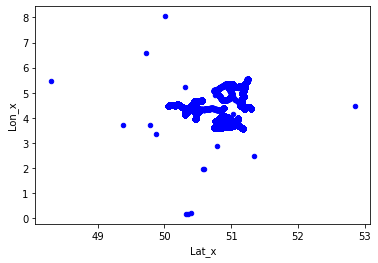

In [19]:
# global plot
correlation_df.plot.scatter(x='Lat_x',
                            y='Lon_x',
                            c='Blue');

In [20]:
# Remove NaN values
correlation_df['Distance'].fillna(0, inplace=True)
correlation_df['Speed'].fillna(0, inplace=True)
correlation_df['Prev_speed'].fillna(0, inplace=True)
correlation_df['Acceleration'].fillna(0, inplace=True)

In [21]:
# Identify NaN values 
def identify_nan_columns(dataframe):
    nan_columns = []
    for column in dataframe.columns:
        if dataframe[column].isnull().any():
            nan_columns.append(column)

    return nan_columns

identify_nan_columns(correlation_df)

['RS_E_InAirTemp_PC2',
 'RS_E_OilPress_PC2',
 'RS_E_RPM_PC2',
 'RS_E_WatTemp_PC2',
 'RS_T_OilTemp_PC2',
 'Mean_RS_E_RPM_PC2',
 'Mean_RS_E_OilPress_PC2',
 'Mean_RS_E_WatTemp_PC2']

In [22]:
correlation_df.loc[correlation_df.isna().any(axis=1)]


,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_RPM,Mean_RS_E_OilPress_PC1,Mean_RS_E_OilPress_PC2,Combined_Mean_RS_E_OilPress,Mean_RS_E_InAirTemp_PC1,Mean_RS_E_InAirTemp_PC2,Combined_Mean_RS_E_InAirTemp,Mean_RS_E_WatTemp_PC1,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp
1963,8971680,102.0,2023-01-24,09:26:06,51.039982,3.693444,0.000641,10.0,2.306647e-04,2.295529e-03,...,802.0,203.0,NaN,203.0,20.0,20.0,20.0,78.0,NaN,78.0
5265,12089900,102.0,2023-01-26,12:12:58,51.029650,3.746781,0.003850,30.0,4.620475e-04,4.528688e-04,...,801.0,196.0,NaN,196.0,26.0,26.0,26.0,86.0,NaN,86.0
6531,14993696,102.0,2023-01-27,07:57:30,50.770367,3.872123,0.000007,24.0,1.048392e-06,1.481851e-04,...,799.0,220.0,NaN,220.0,17.0,17.0,17.0,78.0,NaN,78.0
9944,11793356,102.0,2023-02-01,15:15:21,51.035746,3.711026,0.000659,11.0,2.155815e-04,6.239589e-05,...,933.0,269.0,NaN,269.0,23.0,23.0,23.0,78.0,NaN,78.0
11008,12683110,102.0,2023-02-02,05:08:19,50.742537,3.603276,0.000632,5.0,4.546978e-04,4.554693e-04,...,801.0,227.0,NaN,227.0,21.0,21.0,21.0,78.0,NaN,78.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1163306,4573135,123.0,2023-05-14,11:25:53,50.930672,5.327444,0.000010,10.0,3.686266e-06,4.207219e-05,...,802.0,213.0,NaN,213.0,37.0,37.0,37.0,79.0,NaN,79.0
1164145,7471658,123.0,2023-05-15,05:41:57,51.246199,5.542882,0.000008,30.0,1.002557e-06,2.144121e-06,...,798.0,220.0,NaN,220.0,37.0,37.0,37.0,74.0,NaN,74.0
1164416,9979696,123.0,2023-05-15,10:07:04,50.930730,5.327507,0.000016,30.0,1.926663e-06,1.880787e-06,...,799.0,217.0,NaN,217.0,38.0,38.0,38.0,77.0,NaN,77.0
1169821,6204816,123.0,2023-05-22,16:02:34,50.930883,5.327126,0.000013,10.0,4.576958e-06,7.862519e-07,...,0.0,3.0,NaN,3.0,75.0,75.0,75.0,74.0,NaN,74.0


'Distance' => can be set to 0 as it's a number expected.
'Speed'  => can be set to 0 as it's a number expected.
'Prev_speed'  => can be set to 0 as it's a number expected.
'Acceleration'  => can be set to 0 as it's a number expected.

'RS_E_InAirTemp_PC2' => To be computed
'RS_E_OilPress_PC2' => To be computed
'RS_E_RPM_PC2' => To be computed
'RS_E_WatTemp_PC2' => To be computed
'RS_T_OilTemp_PC2' => To be computed

In [23]:
# Impute missing values using interpolation
from scipy.interpolate import interp1d

# Create interpolation functions for all temperature columns
air_temp_interpolator = interp1d(correlation_df['RS_E_InAirTemp_PC2'].dropna().index, correlation_df['RS_E_InAirTemp_PC2'].dropna())
oil_press_interpolator = interp1d(correlation_df['RS_E_OilPress_PC2'].dropna().index, correlation_df['RS_E_OilPress_PC2'].dropna())
rpm_interpolator = interp1d(correlation_df['RS_E_RPM_PC2'].dropna().index, correlation_df['RS_E_RPM_PC2'].dropna())
wat_temp_interpolator = interp1d(correlation_df['RS_E_WatTemp_PC2'].dropna().index, correlation_df['RS_E_WatTemp_PC2'].dropna())
oil_temp_interpolator = interp1d(correlation_df['RS_T_OilTemp_PC2'].dropna().index, correlation_df['RS_T_OilTemp_PC2'].dropna())

# Impute missing values using interpolation for all temperature columns
for index in correlation_df.index:
    if np.isnan(correlation_df.loc[index, 'RS_E_InAirTemp_PC2']):
        correlation_df.loc[index, 'RS_E_InAirTemp_PC2'] = air_temp_interpolator(index)
    if np.isnan(correlation_df.loc[index, 'RS_E_OilPress_PC2']):
        correlation_df.loc[index, 'RS_E_OilPress_PC2'] = oil_press_interpolator(index)
    if np.isnan(correlation_df.loc[index, 'RS_E_RPM_PC2']):
        correlation_df.loc[index, 'RS_E_RPM_PC2'] = rpm_interpolator(index)
    if np.isnan(correlation_df.loc[index, 'RS_E_WatTemp_PC2']):
        correlation_df.loc[index, 'RS_E_WatTemp_PC2'] = wat_temp_interpolator(index)
    if np.isnan(correlation_df.loc[index, 'RS_T_OilTemp_PC2']):
        correlation_df.loc[index, 'RS_T_OilTemp_PC2'] = oil_temp_interpolator(index)

correlation_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_RPM,Mean_RS_E_OilPress_PC1,Mean_RS_E_OilPress_PC2,Combined_Mean_RS_E_OilPress,Mean_RS_E_InAirTemp_PC1,Mean_RS_E_InAirTemp_PC2,Combined_Mean_RS_E_InAirTemp,Mean_RS_E_WatTemp_PC1,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp
0,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,0.000000,0.0,0.000000,0.000000,...,848.5,210.0,210.0,210.0,17.0,17.0,17.5,78.0,80.0,79.0
1,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,0.000034,8.0,0.000015,0.000000,...,802.5,200.0,200.0,200.0,17.0,17.0,18.5,79.0,80.0,79.5
2,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,0.001314,21.0,0.000225,0.000015,...,805.5,193.0,207.0,200.0,19.0,19.0,19.5,80.0,81.0,80.5
3,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,0.000905,4.0,0.000815,0.000225,...,802.0,196.0,203.0,199.5,19.0,19.0,19.5,80.0,81.0,80.5
4,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,0.001219,29.0,0.000151,0.000815,...,801.0,200.0,203.0,201.5,19.0,19.0,20.0,80.0,82.0,81.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,861607,123.0,2023-06-08,02:08:37,50.935961,5.310076,0.001197,60.0,0.000072,0.000001,...,816.0,369.0,334.0,351.5,20.0,20.0,22.5,56.0,59.0,57.5
1176528,1551506,123.0,2023-06-08,02:09:37,50.936620,5.307362,0.002793,60.0,0.000168,0.000072,...,802.0,351.0,338.0,344.5,21.0,21.0,23.0,57.0,60.0,58.5
1176529,15755138,123.0,2023-06-08,02:10:38,50.936810,5.306624,0.000762,61.0,0.000045,0.000168,...,817.0,365.0,355.0,360.0,22.0,22.0,23.5,57.0,60.0,58.5
1176530,10779814,123.0,2023-06-08,02:11:38,50.936870,5.306676,0.000080,60.0,0.000005,0.000045,...,0.0,3.0,6.0,4.5,27.0,27.0,28.5,57.0,60.0,58.5


# Check correlation in the dataframe

In [24]:
# Calculate the correlation matrix
correlation_matrix = correlation_df

# Find the maximum correlation value for each column
max_correlations = correlation_matrix.max(axis=1)

# Filter out correlations below the threshold
filtered_max_correlations = max_correlations[(max_correlations >= -correlation_threshold) & (max_correlations <= correlation_threshold)]

# Create a DataFrame with the highest correlation values
highest_correlations = pd.DataFrame({'Column': filtered_max_correlations.index, 'Correlation Value': filtered_max_correlations.values})

# Print the results
print("Highest Correlations:")
print(highest_correlations)

TypeError: '>=' not supported between instances of 'int' and 'str'

In [25]:
# Dataframe for breakdown train
breakdown_df = correlation_df[correlation_df['Breakdown'] == 1]
breakdown_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_RPM,Mean_RS_E_OilPress_PC1,Mean_RS_E_OilPress_PC2,Combined_Mean_RS_E_OilPress,Mean_RS_E_InAirTemp_PC1,Mean_RS_E_InAirTemp_PC2,Combined_Mean_RS_E_InAirTemp,Mean_RS_E_WatTemp_PC1,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp
0,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,0.000000,0.0,0.000000,0.000000,...,848.5,210.0,210.0,210.0,17.0,17.0,17.5,78.0,80.0,79.0
1,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,0.000034,8.0,0.000015,0.000000,...,802.5,200.0,200.0,200.0,17.0,17.0,18.5,79.0,80.0,79.5
2,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,0.001314,21.0,0.000225,0.000015,...,805.5,193.0,207.0,200.0,19.0,19.0,19.5,80.0,81.0,80.5
3,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,0.000905,4.0,0.000815,0.000225,...,802.0,196.0,203.0,199.5,19.0,19.0,19.5,80.0,81.0,80.5
4,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,0.001219,29.0,0.000151,0.000815,...,801.0,200.0,203.0,201.5,19.0,19.0,20.0,80.0,82.0,81.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,861607,123.0,2023-06-08,02:08:37,50.935961,5.310076,0.001197,60.0,0.000072,0.000001,...,816.0,369.0,334.0,351.5,20.0,20.0,22.5,56.0,59.0,57.5
1176528,1551506,123.0,2023-06-08,02:09:37,50.936620,5.307362,0.002793,60.0,0.000168,0.000072,...,802.0,351.0,338.0,344.5,21.0,21.0,23.0,57.0,60.0,58.5
1176529,15755138,123.0,2023-06-08,02:10:38,50.936810,5.306624,0.000762,61.0,0.000045,0.000168,...,817.0,365.0,355.0,360.0,22.0,22.0,23.5,57.0,60.0,58.5
1176530,10779814,123.0,2023-06-08,02:11:38,50.936870,5.306676,0.000080,60.0,0.000005,0.000045,...,0.0,3.0,6.0,4.5,27.0,27.0,28.5,57.0,60.0,58.5


In [26]:
# Identify NaN values 
def identify_nan_columns(dataframe):
    nan_columns = []
    for column in dataframe.columns:
        if dataframe[column].isnull().any():
            nan_columns.append(column)

    return nan_columns

identify_nan_columns(breakdown_df)

['Mean_RS_E_RPM_PC2', 'Mean_RS_E_OilPress_PC2', 'Mean_RS_E_WatTemp_PC2']

In [27]:
print(breakdown_df.iloc[2000])

Row_number                        10883607
Mapped_veh_id                        102.0
Dates                           2023-01-28
Time                              09:31:42
Lat_x                            51.013332
Lon_x                             3.781048
Distance                          0.000145
Time_elapsed                          60.0
Speed                             0.000009
Prev_speed                        0.000008
Acceleration                           0.0
RS_E_InAirTemp_PC1                    25.0
RS_E_InAirTemp_PC2                    21.0
RS_E_OilPress_PC1                      0.0
RS_E_OilPress_PC2                      0.0
RS_E_RPM_PC1                           0.0
RS_E_RPM_PC2                           0.0
RS_E_WatTemp_PC1                      27.0
RS_E_WatTemp_PC2                      21.0
RS_T_OilTemp_PC1                      19.0
RS_T_OilTemp_PC2                      18.0
Repair                                   1
Breakdown                                1
Mean_RS_E_R

In [28]:
# Dataframe without breakdown
data_df = correlation_df[correlation_df['Breakdown'] == 0]
data_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_RPM,Mean_RS_E_OilPress_PC1,Mean_RS_E_OilPress_PC2,Combined_Mean_RS_E_OilPress,Mean_RS_E_InAirTemp_PC1,Mean_RS_E_InAirTemp_PC2,Combined_Mean_RS_E_InAirTemp,Mean_RS_E_WatTemp_PC1,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,813.5,241.0,251.0,246.00,11.0,11.0,9.5,68.0,68.0,68.0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,834.0,231.0,269.0,250.00,12.0,12.0,10.0,68.0,68.0,68.0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,801.0,244.0,251.0,247.50,12.0,12.0,11.0,68.0,69.0,68.5
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,798.5,241.0,251.0,246.00,12.0,12.0,11.0,68.0,69.0,68.5
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,801.0,244.0,256.5,250.25,13.0,13.0,11.5,68.0,68.0,68.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,1382.0,317.0,338.0,327.50,42.0,42.0,42.0,85.0,84.0,84.5
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,1901.5,355.0,372.0,363.50,40.0,40.0,41.5,80.0,84.0,82.0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,1499.5,355.0,351.0,353.00,38.0,38.0,40.0,80.0,82.0,81.0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,793.0,172.0,193.0,182.50,38.0,38.0,38.5,88.0,86.0,87.0


In [29]:
# Identify NaN values 
def identify_nan_columns(dataframe):
    nan_columns = []
    for column in dataframe.columns:
        if dataframe[column].isnull().any():
            nan_columns.append(column)

    return nan_columns

identify_nan_columns(data_df)

['Mean_RS_E_RPM_PC2', 'Mean_RS_E_OilPress_PC2', 'Mean_RS_E_WatTemp_PC2']

In [30]:
air_threshold = 65
water_threshold = 100
oil_threshold = 115

def check_temperature(temperature, threshold):
    if temperature <= threshold:
        return 0
    else:
        return 1

data_df["Air_Temp_Status_PC1"] = data_df["RS_E_InAirTemp_PC1"].apply(check_temperature, args=(air_threshold,))
data_df["Air_Temp_Status_PC2"] = data_df["RS_E_InAirTemp_PC2"].apply(check_temperature, args=(air_threshold,))
data_df["Water_Temp_Status_PC1"] = data_df["RS_E_WatTemp_PC1"].apply(check_temperature, args=(water_threshold,))
data_df["Water_Temp_Status_PC2"] = data_df["RS_E_WatTemp_PC2"].apply(check_temperature, args=(water_threshold,))
data_df["Oil_Temp_Status_PC1"] = data_df["RS_T_OilTemp_PC1"].apply(check_temperature, args=(oil_threshold,))
data_df["Oil_Temp_Status_PC2"] = data_df["RS_T_OilTemp_PC2"].apply(check_temperature, args=(oil_threshold,))

# Create a global status  :

def global_check_vehicle_status(row):
    if row["Air_Temp_Status_PC1"] == 1 or row["Air_Temp_Status_PC2"] == 1 or row["Water_Temp_Status_PC1"] == 1 or row["Water_Temp_Status_PC2"] == 1 or row["Oil_Temp_Status_PC1"] == 1 or row["Oil_Temp_Status_PC2"] == 1 :
        return "Symptoms"
    else:
        return "No Symptoms"
    
def check_specific_vehicle_status_PC1(row):
    if row["Air_Temp_Status_PC1"] == 1 or row["Water_Temp_Status_PC1"] == 1 or row["Oil_Temp_Status_PC1"] == 1 :
        return 1
    else:
        return 0
    
def check_specific_vehicle_status_PC2(row):
    if row["Air_Temp_Status_PC2"] == 1 or row["Water_Temp_Status_PC2"] == 1 or row["Oil_Temp_Status_PC2"] == 1 :
        return 1
    else:
        return 0

data_df["Global_Vehicle_Status"] = data_df.apply(global_check_vehicle_status, axis=1)
data_df["Vehicule_Status_PC1"] = data_df.apply(check_specific_vehicle_status_PC1, axis=1)
data_df["Vehicule_Status_PC2"] = data_df.apply(check_specific_vehicle_status_PC2, axis=1)
data_df

2023-11-25 14:45:36,177 [9544] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-30-d60e380c2162>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_df["Air_Temp_Status_PC1"] = data_df["RS_E_InAirTemp_PC1"].apply(check_temperature, args=(air_threshold,))

2023-11-25 14:45:36,634 [9544] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-30-d60e380c2162>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_df["Air_Temp_Status_PC2"] = data_df["RS_E_InAirTemp_PC2"].apply(check_temperature, 

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Global_Vehicle_Status,Vehicule_Status_PC1,Vehicule_Status_PC2
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,84.5,0,0,0,0,0,0,No Symptoms,0,0
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,82.0,0,0,0,0,0,0,No Symptoms,0,0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,81.0,0,0,0,0,0,0,No Symptoms,0,0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,87.0,0,0,0,0,0,0,No Symptoms,0,0


In [31]:
# split data between symptomatic cases and not

# symptomatic df then 1
symptoms_df = data_df[data_df["Global_Vehicle_Status"] == "Symptoms"]
symptoms_df


# not symptomatic df then 0
asymptoms_df = data_df[data_df["Global_Vehicle_Status"] == "No Symptoms"]
asymptoms_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Global_Vehicle_Status,Vehicule_Status_PC1,Vehicule_Status_PC2
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,84.5,0,0,0,0,0,0,No Symptoms,0,0
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,82.0,0,0,0,0,0,0,No Symptoms,0,0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,81.0,0,0,0,0,0,0,No Symptoms,0,0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,87.0,0,0,0,0,0,0,No Symptoms,0,0


In [32]:
# Calculate the correlation
correlation_rpm1_speed = asymptoms_df['RS_E_RPM_PC1'].corr(asymptoms_df['Speed'])
correlation_rpm2_speed = asymptoms_df['RS_E_RPM_PC2'].corr(asymptoms_df['Speed'])

correlation_rpm1_acceleration = asymptoms_df['RS_E_RPM_PC1'].corr(asymptoms_df['Acceleration'])
correlation_rpm2_acceleration = asymptoms_df['RS_E_RPM_PC2'].corr(asymptoms_df['Acceleration'])

# Print the correlation coefficients
print(correlation_rpm1_speed)
print(correlation_rpm2_speed)

print(correlation_rpm1_acceleration)
print(correlation_rpm2_acceleration)

0.010851163275367766
0.014927217275150999
-0.0019145747803403818
-0.00040061560711751576


In [33]:
correlation_rpm1_rpm2 = asymptoms_df['RS_E_RPM_PC1'].corr(asymptoms_df['RS_E_RPM_PC2'])
correlation_speed_acceleration = asymptoms_df['Speed'].corr(asymptoms_df['Acceleration'])

# Print the correlation coefficients
print(correlation_rpm1_rpm2)
print(correlation_speed_acceleration)

0.724698693650847
0.9320471142707893


In [34]:
# Identify NaN values 
def identify_nan_columns(dataframe):
    nan_columns = []
    for column in dataframe.columns:
        if dataframe[column].isnull().any():
            nan_columns.append(column)

    return nan_columns

identify_nan_columns(asymptoms_df)

['Mean_RS_E_RPM_PC2', 'Mean_RS_E_OilPress_PC2', 'Mean_RS_E_WatTemp_PC2']

# Simple EDA representation

In [35]:
# Print the dataframe :
asymptoms_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Global_Vehicle_Status,Vehicule_Status_PC1,Vehicule_Status_PC2
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,84.5,0,0,0,0,0,0,No Symptoms,0,0
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,82.0,0,0,0,0,0,0,No Symptoms,0,0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,81.0,0,0,0,0,0,0,No Symptoms,0,0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,87.0,0,0,0,0,0,0,No Symptoms,0,0


In [36]:
# simple EDA

# Univariate analysis
breakdown_df.describe()

# Maintenance trains
breakdown_df.describe()

# No maintenance trains
asymptoms_df.describe()

,Row_number,Mapped_veh_id,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,Acceleration,RS_E_InAirTemp_PC1,...,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Vehicule_Status_PC1,Vehicule_Status_PC2
count,9.202510e+05,920251.000000,920251.000000,920251.000000,920251.000000,920251.000000,920251.000000,920251.000000,9.202510e+05,920251.000000,...,920085.000000,920251.000000,920251.0,920251.0,920251.0,920251.0,920251.0,920251.0,920251.0,920251.0
mean,8.851378e+06,157.034080,50.893681,4.455690,0.003702,40.331662,0.000577,0.000578,1.148849e-04,31.419571,...,77.404177,77.221741,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,5.100537e+06,33.097173,0.367778,0.613050,0.014475,345.949071,0.013972,0.014091,1.192715e-02,11.508055,...,14.073871,11.026937,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,7.000000e+00,102.000000,48.295677,0.175049,0.000000,0.000000,0.000000,0.000000,-2.816822e-01,0.000000,...,-3.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,4.436916e+06,123.000000,50.750830,3.791995,0.000468,8.000000,0.000042,0.000042,-6.497287e-06,24.000000,...,78.000000,77.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,8.876778e+06,172.000000,51.039105,4.497095,0.000662,46.000000,0.000302,0.000302,1.054975e-10,34.000000,...,81.500000,80.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,1.326368e+07,174.000000,51.189401,5.111525,0.003718,58.000000,0.000804,0.000804,1.512198e-05,40.000000,...,84.000000,83.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,1.767926e+07,194.000000,52.857059,8.045492,4.242205,78451.000000,11.267762,11.267762,1.107715e+01,65.000000,...,100.000000,98.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [37]:
asymptoms_df['Mapped_veh_id'].value_counts().sort_values(ascending=False)

Mapped_veh_id
172.0    342790
194.0    155654
102.0    150928
174.0    148088
123.0     65838
107.0     56953
Name: count, dtype: int64

In [38]:
merged_df.columns

Index(['Unnamed: 0', 'Row_number', 'Mapped_veh_id', 'Dates', 'Time',
       'Distance', 'Lat_x', 'Lon_x', 'Time_elapsed', 'Speed',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'Station',
       'Round_time', 'Temperature', 'Rel_hum', 'Precipitation', 'Pressure',
       'Repair', 'Breakdown', 'Prev_speed', 'Acceleration'],
      dtype='object')

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      153.911     157.034    157.932
std        36.519      33.097     25.995
min       102.000     102.000    102.000
25%       107.000     123.000    123.000
50%       172.000     172.000    172.000
75%       174.000     174.000    172.000
max       194.000     194.000    194.000


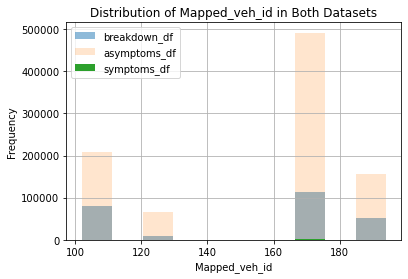

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean        0.000       0.001      0.000
std         0.010       0.014      0.001
min         0.000       0.000      0.000
25%         0.000       0.000      0.000
50%         0.000       0.000      0.000
75%         0.000       0.001      0.001
max         4.343      11.268      0.004


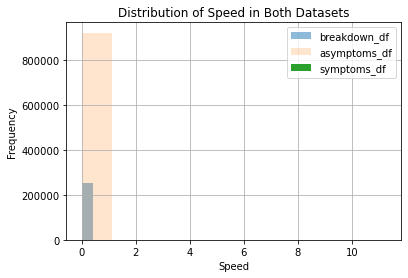

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean        0.000       0.001      0.000
std         0.010       0.014      0.001
min         0.000       0.000      0.000
25%         0.000       0.000      0.000
50%         0.000       0.000      0.000
75%         0.000       0.001      0.001
max         4.343      11.268      0.003


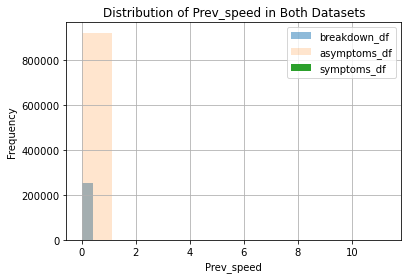

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean        0.000       0.000      0.000
std         0.004       0.012      0.000
min        -0.145      -0.282     -0.001
25%        -0.000      -0.000     -0.000
50%         0.000       0.000      0.000
75%         0.000       0.000      0.000
max         1.231      11.077      0.003


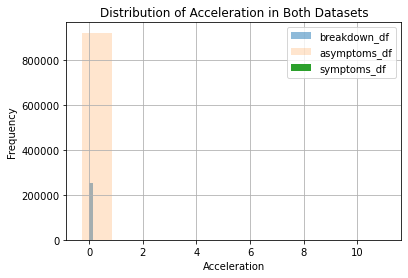

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      752.891     939.859    569.986
std       354.737     432.857    569.809
min         0.000       0.000      0.000
25%       796.000     798.000      0.000
50%       799.000     801.000    796.000
75%       803.000     898.000    802.000
max      2240.000    2279.000   2001.000


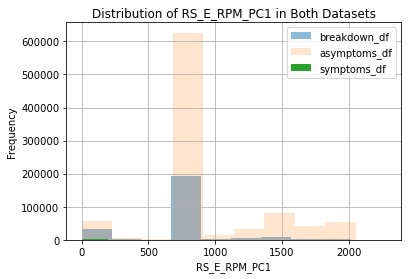

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      789.990     976.604    303.674
std       337.827     404.605    565.448
min         0.000       0.000      0.000
25%       796.000     798.000      0.000
50%       800.000     802.000      0.000
75%       804.000    1084.000    789.000
max      2274.000    2307.000   1990.000


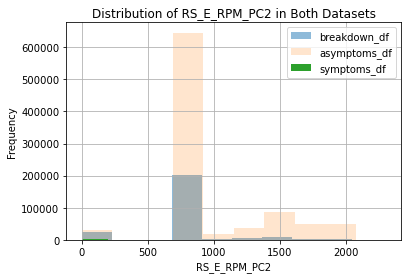

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       32.410      31.420   1077.660
std       582.277      11.508   8139.676
min         0.000       0.000      0.000
25%        18.000      24.000     36.000
50%        28.000      34.000     51.000
75%        36.000      40.000     66.000
max     65535.000      65.000  65535.000


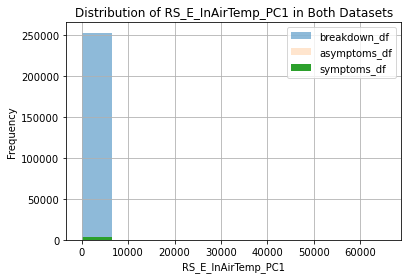

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       33.247      32.904     63.394
std       520.799       9.994     12.912
min         0.000       0.000      0.000
25%        22.000      27.000     66.000
50%        30.000      35.000     67.000
75%        37.000      40.000     70.000
max     65535.000      65.000     82.000


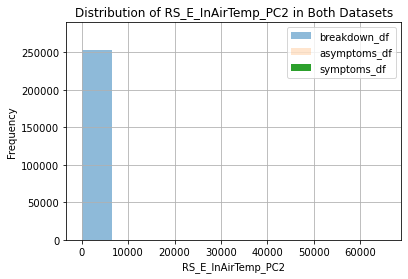

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      223.606     238.205    134.778
std       110.301      91.544    124.703
min         0.000       0.000      0.000
25%       189.000     186.000      3.000
50%       210.000     207.000    182.000
75%       282.000     303.000    210.000
max       683.000     641.000    431.000


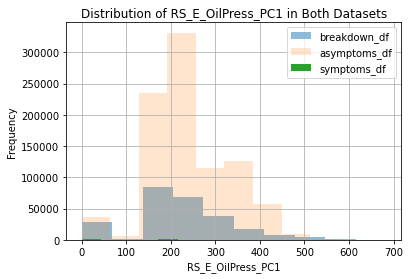

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      252.403     262.266     71.672
std       114.982      88.247    123.142
min         0.000       0.000      0.000
25%       213.000     210.000      3.000
50%       241.000     238.000      3.000
75%       300.000     338.000    165.000
max       669.000     645.000    424.000


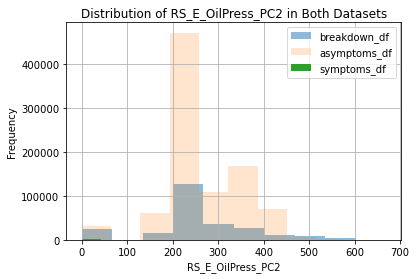

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       70.898      77.039     77.505
std        19.345      14.472     10.993
min         0.000       0.000      0.000
25%        68.000      77.000     76.000
50%        78.000      80.000     78.000
75%        81.000      83.000     84.000
max        97.000      98.000     98.000


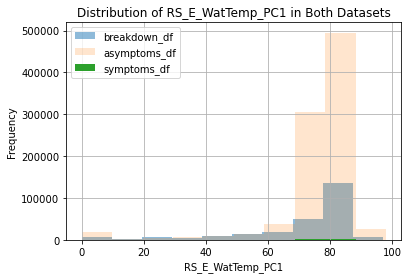

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       70.893      77.404     75.972
std        18.840      14.074     11.559
min         0.000      -3.000      0.000
25%        63.000      78.000     70.000
50%        80.000      81.500     77.000
75%        82.000      84.000     82.000
max       107.000     100.000    105.000


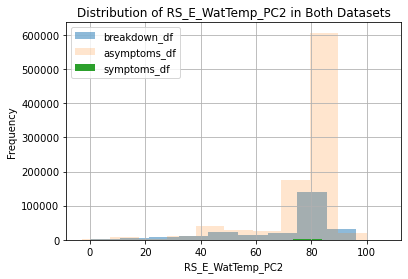

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       69.354      77.609     78.553
std        17.703      12.324      7.564
min         0.000       0.000     31.000
25%        65.000      76.000     77.000
50%        76.000      80.000     79.000
75%        81.000      84.000     82.000
max       105.000     103.000    101.000


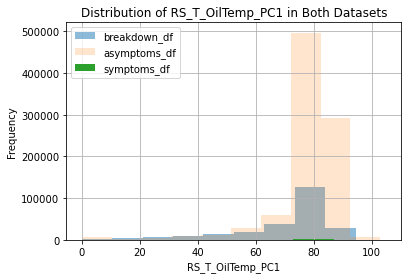

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       70.875      79.831     79.032
std        18.457      11.768      8.636
min         0.000       0.000     61.000
25%        66.000      78.000     73.000
50%        78.000      82.000     79.000
75%        82.000      86.000     83.500
max       109.000     112.000    116.000


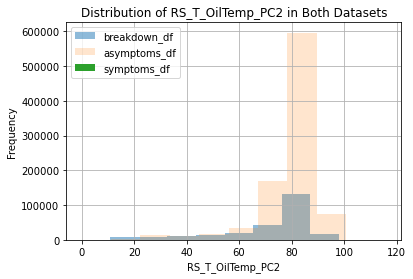

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      752.891     939.859    569.986
std       354.737     432.857    569.809
min         0.000       0.000      0.000
25%       796.000     798.000      0.000
50%       799.000     801.000    796.000
75%       803.000     898.000    802.000
max      2240.000    2279.000   2001.000


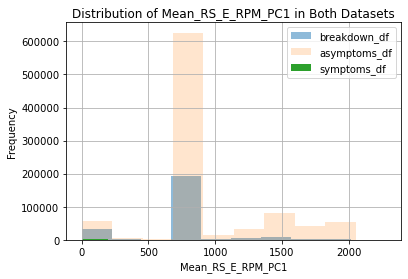

        Dataset 1   Dataset 2  Dataset 3
count  253024.000  920085.000   3059.000
mean      790.399     976.658    303.674
std       337.514     404.591    565.448
min         0.000       0.000      0.000
25%       796.000     798.000      0.000
50%       800.000     802.000      0.000
75%       804.000    1084.000    789.000
max      2274.000    2307.000   1990.000


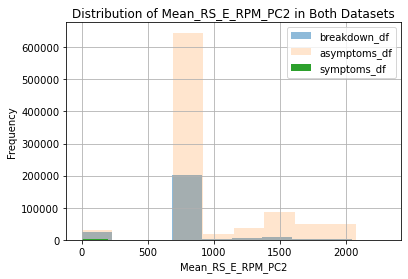

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      771.469     958.250    436.830
std       317.718     388.883    428.784
min         0.000       0.000      0.000
25%       796.500     798.000      0.000
50%       799.500     801.000    399.500
75%       802.000     948.500    405.750
max      1993.500    2273.000   1991.500


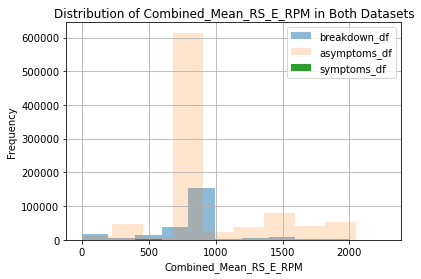

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      223.606     238.205    134.778
std       110.301      91.544    124.703
min         0.000       0.000      0.000
25%       189.000     186.000      3.000
50%       210.000     207.000    182.000
75%       282.000     303.000    210.000
max       683.000     641.000    431.000


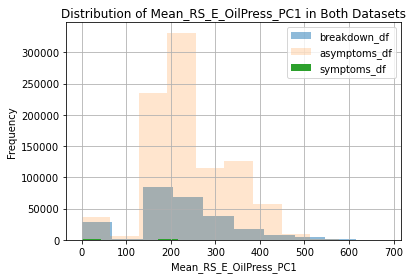

        Dataset 1   Dataset 2  Dataset 3
count  253024.000  920085.000   3059.000
mean      252.521     262.279     71.672
std       114.888      88.240    123.142
min         0.000       0.000      0.000
25%       213.000     210.000      3.000
50%       241.000     238.000      3.000
75%       300.000     338.000    165.000
max       669.000     645.000    424.000


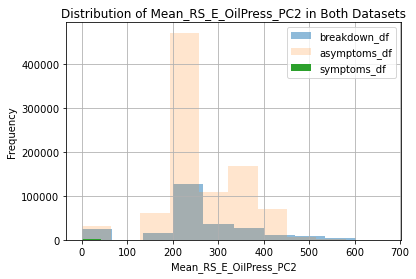

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean      238.002     250.240    103.225
std       104.569      82.027     88.949
min         0.000       0.000      1.500
25%       204.500     200.500      3.000
50%       225.500     222.000    103.000
75%       282.500     309.646    118.125
max       631.000     627.000    379.000


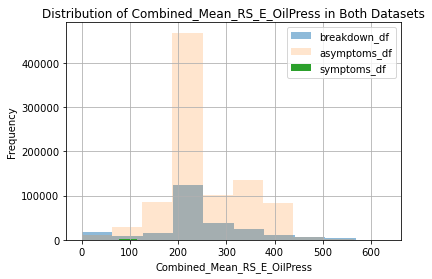

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       32.410      31.420   1077.660
std       582.277      11.508   8139.676
min         0.000       0.000      0.000
25%        18.000      24.000     36.000
50%        28.000      34.000     51.000
75%        36.000      40.000     66.000
max     65535.000      65.000  65535.000


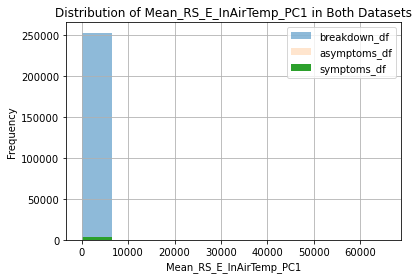

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       32.410      31.420   1077.660
std       582.277      11.508   8139.676
min         0.000       0.000      0.000
25%        18.000      24.000     36.000
50%        28.000      34.000     51.000
75%        36.000      40.000     66.000
max     65535.000      65.000  65535.000


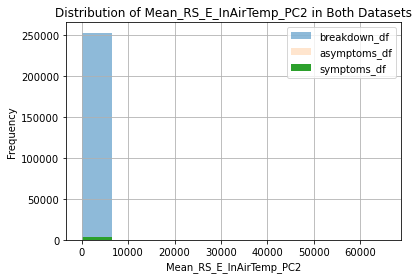

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       32.828      32.162    570.527
std       495.738       9.946   4066.340
min         0.000       0.000     33.000
25%        20.500      25.500     52.000
50%        28.500      34.500     57.000
75%        36.000      39.500     64.000
max     65535.000      65.000  32772.500


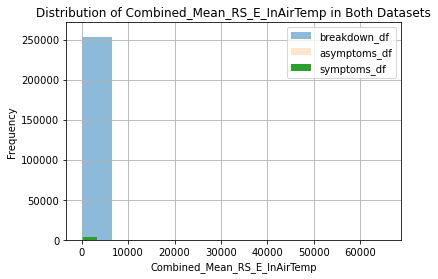

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       70.898      77.039     77.505
std        19.345      14.472     10.993
min         0.000       0.000      0.000
25%        68.000      77.000     76.000
50%        78.000      80.000     78.000
75%        81.000      83.000     84.000
max        97.000      98.000     98.000


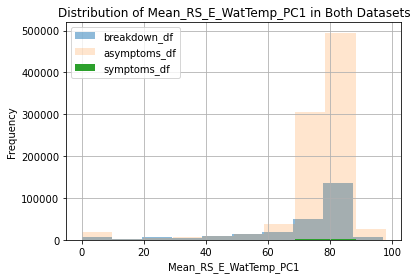

        Dataset 1   Dataset 2  Dataset 3
count  253024.000  920085.000   3059.000
mean       70.918      77.404     75.972
std        18.807      14.074     11.559
min         0.000      -3.000      0.000
25%        63.000      78.000     70.000
50%        80.000      81.500     77.000
75%        82.000      84.000     82.000
max       107.000     100.000    105.000


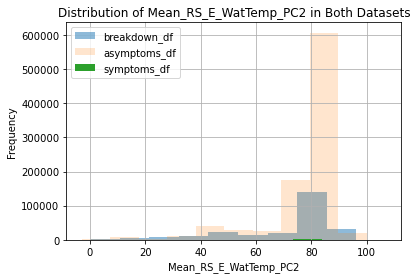

        Dataset 1   Dataset 2  Dataset 3
count  253222.000  920251.000   3059.000
mean       70.895      77.222     76.738
std        16.607      11.027      7.422
min         0.000       0.000     36.000
25%        62.500      77.000     73.000
50%        78.000      80.000     77.000
75%        81.500      83.500     80.500
max        96.500      98.500     99.500


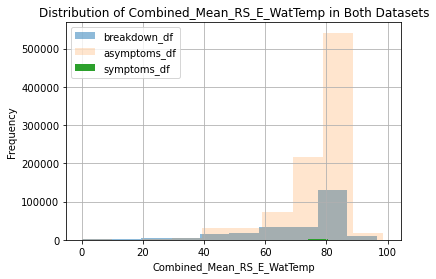

       Dataset 1  Dataset 2  Dataset 3
count   253222.0   920251.0     3059.0
mean         1.0        0.0        0.0
std          0.0        0.0        0.0
min          1.0        0.0        0.0
25%          1.0        0.0        0.0
50%          1.0        0.0        0.0
75%          1.0        0.0        0.0
max          1.0        0.0        0.0


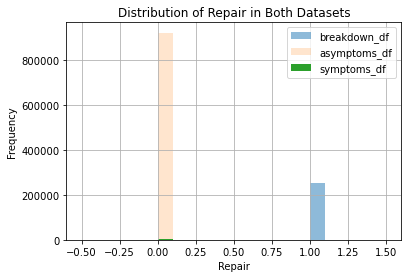

       Dataset 1  Dataset 2  Dataset 3
count   253222.0   920251.0     3059.0
mean         1.0        0.0        0.0
std          0.0        0.0        0.0
min          1.0        0.0        0.0
25%          1.0        0.0        0.0
50%          1.0        0.0        0.0
75%          1.0        0.0        0.0
max          1.0        0.0        0.0


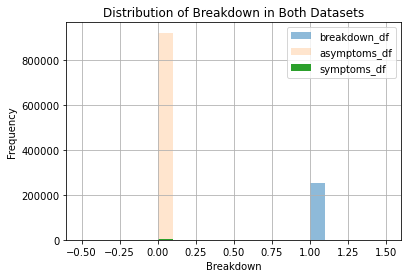

In [39]:
import pandas as pd
import matplotlib.pyplot as plt
from io import BytesIO
from fpdf import FPDF

def compare_distributions(df1, df2, df3, features):
    pdf = FPDF()
    for feature in features:
        plt.figure()

        # Plot distributions for both datasets
        df1[feature].hist(alpha=0.5, label='breakdown_df')
        df2[feature].hist(alpha=0.2, label='asymptoms_df')
        df3[feature].hist(alpha=1.0, label='symptoms_df')

        # Add labels and title
        plt.xlabel(feature)
        plt.ylabel('Frequency')
        plt.title(f'Distribution of {feature} in Both Datasets')

        # Calculate and display statistics
        df1_stats = df1[feature].describe()
        df2_stats = df2[feature].describe()
        df3_stats = df3[feature].describe()
        stats_comparison = pd.DataFrame({
            'Dataset 1': df1_stats,
            'Dataset 2': df2_stats,
            'Dataset 3': df3_stats
        }).round(3)
        print(stats_comparison)

        # Show the plot
        plt.legend()
        plt.show()


features = ['Mapped_veh_id','Speed','Prev_speed','Acceleration','RS_E_RPM_PC1','RS_E_RPM_PC2','RS_E_InAirTemp_PC1','RS_E_InAirTemp_PC2','RS_E_OilPress_PC1','RS_E_OilPress_PC2','RS_E_WatTemp_PC1','RS_E_WatTemp_PC2','RS_T_OilTemp_PC1','RS_T_OilTemp_PC2','Mean_RS_E_RPM_PC1','Mean_RS_E_RPM_PC2','Combined_Mean_RS_E_RPM','Mean_RS_E_OilPress_PC1','Mean_RS_E_OilPress_PC2','Combined_Mean_RS_E_OilPress','Mean_RS_E_InAirTemp_PC1','Mean_RS_E_InAirTemp_PC2','Combined_Mean_RS_E_InAirTemp','Mean_RS_E_WatTemp_PC1','Mean_RS_E_WatTemp_PC2','Combined_Mean_RS_E_WatTemp','Repair','Breakdown']
compare_distributions(breakdown_df, asymptoms_df, symptoms_df,features)

# Model creation and definition

In [313]:
#asymptoms_df[asymptoms_df['Mapped_veh_id'] == 172]

## Add last derivative to the dataset

In [40]:
asymptoms_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Global_Vehicle_Status,Vehicule_Status_PC1,Vehicule_Status_PC2
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,84.5,0,0,0,0,0,0,No Symptoms,0,0
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,82.0,0,0,0,0,0,0,No Symptoms,0,0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,81.0,0,0,0,0,0,0,No Symptoms,0,0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,87.0,0,0,0,0,0,0,No Symptoms,0,0


In [41]:
# Derivative for RPM
asymptoms_df['Mean_RS_E_RPM_PC1'] = asymptoms_df[['RS_E_RPM_PC1']].mean(axis=1)
asymptoms_df['Mean_RS_E_RPM_PC2'] = asymptoms_df[['RS_E_RPM_PC2']].mean(axis=1)
asymptoms_df['Combined_Mean_RS_E_RPM'] = asymptoms_df[['RS_E_RPM_PC1','RS_E_RPM_PC2']].mean(axis=1)

# Derivative for Oil
asymptoms_df['Mean_RS_E_OilPress_PC1'] = asymptoms_df[['RS_E_OilPress_PC1']].mean(axis=1)
asymptoms_df['Mean_RS_E_OilPress_PC2'] = asymptoms_df[['RS_E_OilPress_PC2']].mean(axis=1)
asymptoms_df['Combined_Mean_RS_E_OilPress'] = asymptoms_df[['RS_E_OilPress_PC1','RS_E_OilPress_PC2']].mean(axis=1)

# Derivative for Air
asymptoms_df['Mean_RS_E_InAirTemp_PC1'] = asymptoms_df[['RS_E_InAirTemp_PC1']].mean(axis=1)
asymptoms_df['Mean_RS_E_InAirTemp_PC2'] = asymptoms_df[['RS_E_InAirTemp_PC1']].mean(axis=1)
asymptoms_df['Combined_Mean_RS_E_InAirTemp'] = asymptoms_df[['RS_E_InAirTemp_PC1','RS_E_InAirTemp_PC2']].mean(axis=1)

# Derivative for Water
asymptoms_df['Mean_RS_E_WatTemp_PC1'] = asymptoms_df[['RS_E_WatTemp_PC1']].mean(axis=1)
asymptoms_df['Mean_RS_E_WatTemp_PC2'] = asymptoms_df[['RS_E_WatTemp_PC2']].mean(axis=1)
asymptoms_df['Combined_Mean_RS_E_WatTemp'] = asymptoms_df[['RS_E_WatTemp_PC1','RS_E_WatTemp_PC2']].mean(axis=1)

# Add the maintenance date information
asymptoms_df

2023-11-25 14:46:44,778 [9544] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-41-b6aefdf56ef9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  asymptoms_df['Mean_RS_E_RPM_PC1'] = asymptoms_df[['RS_E_RPM_PC1']].mean(axis=1)

2023-11-25 14:46:44,864 [9544] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-41-b6aefdf56ef9>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  asymptoms_df['Mean_RS_E_RPM_PC2'] = asymptoms_df[['RS_E_RPM_PC2']].mean(axis=1)

2023-11-25 14:46:44,949 [9544] WARNING  

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Global_Vehicle_Status,Vehicule_Status_PC1,Vehicule_Status_PC2
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,84.5,0,0,0,0,0,0,No Symptoms,0,0
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,82.0,0,0,0,0,0,0,No Symptoms,0,0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,81.0,0,0,0,0,0,0,No Symptoms,0,0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,87.0,0,0,0,0,0,0,No Symptoms,0,0


In [42]:
asymptoms_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_WatTemp,Air_Temp_Status_PC1,Air_Temp_Status_PC2,Water_Temp_Status_PC1,Water_Temp_Status_PC2,Oil_Temp_Status_PC1,Oil_Temp_Status_PC2,Global_Vehicle_Status,Vehicule_Status_PC1,Vehicule_Status_PC2
215,7220121,102.0,2023-01-23,15:52:10,51.031942,3.725422,0.005543,53.0,0.000376,0.000639,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
216,7228516,102.0,2023-01-23,15:52:11,51.031838,3.725924,0.000513,1.0,0.001846,0.000376,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
217,16681062,102.0,2023-01-23,15:53:10,51.033675,3.717584,0.008540,59.0,0.000521,0.001846,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
218,17415157,102.0,2023-01-23,15:53:11,51.033837,3.716803,0.000798,1.0,0.002873,0.000521,...,68.5,0,0,0,0,0,0,No Symptoms,0,0
219,7055279,102.0,2023-01-23,15:54:11,51.035782,3.710726,0.006380,60.0,0.000383,0.002873,...,68.0,0,0,0,0,0,0,No Symptoms,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176427,910292,123.0,2023-06-02,17:44:03,51.026162,5.352076,0.015092,60.0,0.000905,0.000592,...,84.5,0,0,0,0,0,0,No Symptoms,0,0
1176428,6349884,123.0,2023-06-02,17:45:03,51.011207,5.347834,0.015546,60.0,0.000933,0.000905,...,82.0,0,0,0,0,0,0,No Symptoms,0,0
1176429,15731863,123.0,2023-06-02,17:46:03,50.994473,5.348560,0.016749,60.0,0.001005,0.000933,...,81.0,0,0,0,0,0,0,No Symptoms,0,0
1176430,7579112,123.0,2023-06-02,17:46:53,50.990694,5.348743,0.003784,50.0,0.000272,0.001005,...,87.0,0,0,0,0,0,0,No Symptoms,0,0


# Create a first model to predict breakdown

This create one dataset per anomaly and creates a csv file for each of them.

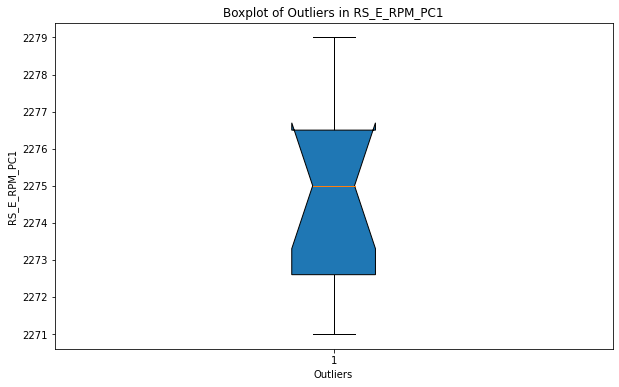

Anomalies detected in feature: RS_E_RPM_PC1
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
234519     11922726          172.0  2023-01-30  20:48:00  51.203907  4.428286   
239932     15937706          172.0  2023-02-01  12:09:18  51.191994  5.122915   
239933     12819340          172.0  2023-02-01  12:09:20  51.191921  5.122541   
239934      6109145          172.0  2023-02-01  12:09:28  51.192247  5.124394   
239935     16653483          172.0  2023-02-01  12:09:29  51.192160  5.123908   
239937      8898713          172.0  2023-02-01  12:09:48  51.192797  5.128420   
239938       683111          172.0  2023-02-01  12:09:50  51.192769  5.128216   
239939      6993050          172.0  2023-02-01  12:10:24  51.190278  5.135243   
239940     16662129          172.0  2023-02-01  12:10:28  51.189284  5.136153   
239941       683114          172.0  2023-02-01  12:10:38  51.187686  5.137640   
385385     16817882          172.0  2023-04-15  07:18:55  51.1875

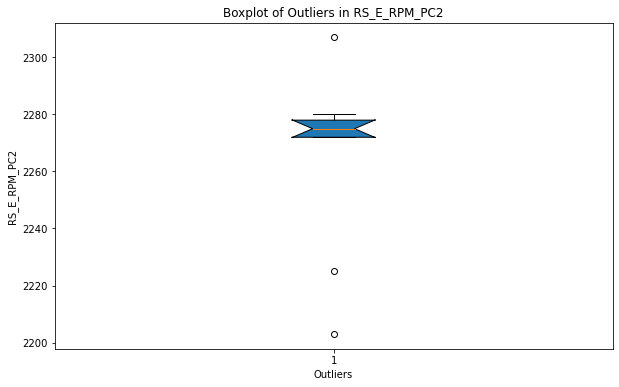

Anomalies detected in feature: RS_E_RPM_PC2
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
113052     11987228          102.0  2023-05-23  20:53:59  50.933003  3.638465   
113053     14238352          102.0  2023-05-23  20:54:18  50.934627  3.637786   
286235      6556855          172.0  2023-02-18  13:15:39  51.196473  4.434755   
286236     10098941          172.0  2023-02-18  13:15:55  51.195469  4.435570   
414836     10851685          172.0  2023-05-14  17:42:11  51.188823  5.136599   
414837     15810052          172.0  2023-05-14  17:42:17  51.188407  5.136981   
699558     17072392          174.0  2023-05-04  04:58:40  50.329040  4.406943   
699559     12461309          174.0  2023-05-04  04:58:47  50.329694  4.407094   
1003092       19894          194.0  2023-08-09  14:36:05  50.777208  3.874036   

         Distance  Time_elapsed     Speed  Prev_speed  ...  \
113052   0.004393          45.0  0.000351    0.000070  ...   
113053   0.001760    

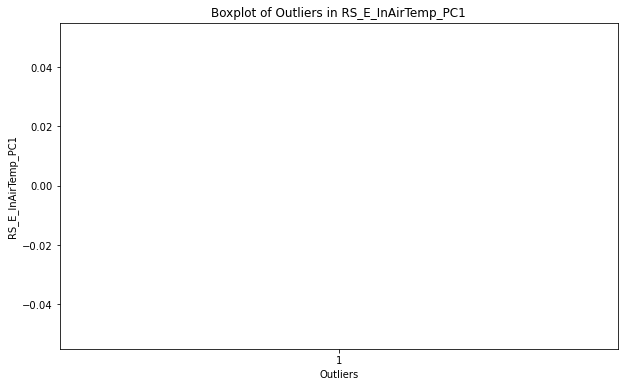

Anomalies detected in feature: RS_E_InAirTemp_PC1
Empty DataFrame
Columns: [Row_number, Mapped_veh_id, Dates, Time, Lat_x, Lon_x, Distance, Time_elapsed, Speed, Prev_speed, Acceleration, RS_E_InAirTemp_PC1, RS_E_InAirTemp_PC2, RS_E_OilPress_PC1, RS_E_OilPress_PC2, RS_E_RPM_PC1, RS_E_RPM_PC2, RS_E_WatTemp_PC1, RS_E_WatTemp_PC2, RS_T_OilTemp_PC1, RS_T_OilTemp_PC2, Repair, Breakdown, Mean_RS_E_RPM_PC1, Mean_RS_E_RPM_PC2, Combined_Mean_RS_E_RPM, Mean_RS_E_OilPress_PC1, Mean_RS_E_OilPress_PC2, Combined_Mean_RS_E_OilPress, Mean_RS_E_InAirTemp_PC1, Mean_RS_E_InAirTemp_PC2, Combined_Mean_RS_E_InAirTemp, Mean_RS_E_WatTemp_PC1, Mean_RS_E_WatTemp_PC2, Combined_Mean_RS_E_WatTemp, Air_Temp_Status_PC1, Air_Temp_Status_PC2, Water_Temp_Status_PC1, Water_Temp_Status_PC2, Oil_Temp_Status_PC1, Oil_Temp_Status_PC2, Global_Vehicle_Status, Vehicule_Status_PC1, Vehicule_Status_PC2]
Index: []

[0 rows x 44 columns]


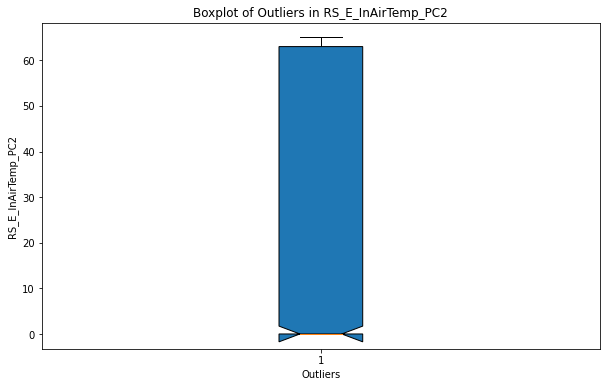

Anomalies detected in feature: RS_E_InAirTemp_PC2
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
986          398010          102.0  2023-01-23  22:36:10  50.855277  3.606160   
987          696044          102.0  2023-01-23  22:36:19  50.855056  3.605874   
1020       12091726          102.0  2023-01-24  01:08:34  50.855096  3.605879   
1021       10885528          102.0  2023-01-24  01:08:40  50.855386  3.606330   
1028       16104950          102.0  2023-01-24  01:11:15  50.855067  3.605902   
...             ...            ...         ...       ...        ...       ...   
1174552    16185663          123.0  2023-05-31  21:41:23  51.189839  5.110763   
1174553    10014741          123.0  2023-05-31  21:41:43  51.189835  5.110754   
1174561     7534655          123.0  2023-05-31  21:48:07  51.190271  5.113277   
1175614     1572242          123.0  2023-06-01  21:41:11  51.190146  5.112567   
1175615     4517281          123.0  2023-06-01  21:41:24  5

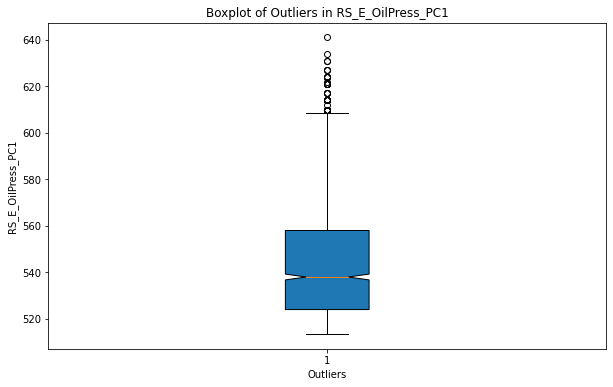

Anomalies detected in feature: RS_E_OilPress_PC1
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
5859       12884338          102.0  2023-01-27  02:13:47  50.774456  3.872824   
5860        3681326          102.0  2023-01-27  02:13:58  50.774051  3.872647   
5861        9359520          102.0  2023-01-27  02:14:47  50.774440  3.872834   
5862        8963628          102.0  2023-01-27  02:14:59  50.774035  3.872664   
5863       14997747          102.0  2023-01-27  02:15:47  50.774447  3.872826   
...             ...            ...         ...       ...        ...       ...   
1132310     4536812          123.0  2023-03-19  18:51:02  51.190774  5.113423   
1132318    15100596          123.0  2023-03-19  18:57:45  51.189300  5.107043   
1132321    13953899          123.0  2023-03-19  18:59:59  51.188205  5.101069   
1132322    14814790          123.0  2023-03-19  19:00:09  51.188269  5.101432   
1132331     3242005          123.0  2023-03-19  19:08:03  51

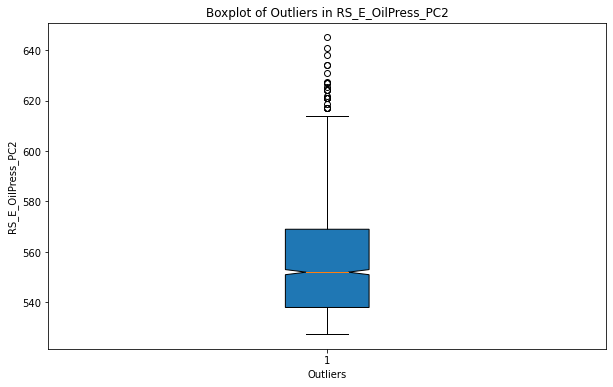

Anomalies detected in feature: RS_E_OilPress_PC2
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
5859       12884338          102.0  2023-01-27  02:13:47  50.774456  3.872824   
5860        3681326          102.0  2023-01-27  02:13:58  50.774051  3.872647   
5861        9359520          102.0  2023-01-27  02:14:47  50.774440  3.872834   
5862        8963628          102.0  2023-01-27  02:14:59  50.774035  3.872664   
5863       14997747          102.0  2023-01-27  02:15:47  50.774447  3.872826   
...             ...            ...         ...       ...        ...       ...   
1132308      945673          123.0  2023-03-19  18:48:58  51.190817  5.113426   
1132309     5283967          123.0  2023-03-19  18:50:02  51.190781  5.113391   
1132318    15100596          123.0  2023-03-19  18:57:45  51.189300  5.107043   
1132321    13953899          123.0  2023-03-19  18:59:59  51.188205  5.101069   
1132322    14814790          123.0  2023-03-19  19:00:09  51

In [68]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the DataFrame
df = asymptoms_df

# Select features related to cooling systems
cooling_features = ['RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1', 'RS_E_OilPress_PC2']

# Detect anomalies using statistical methods
for feature in cooling_features:
    # Calculate Z-scores
    z_scores = (df[feature] - df[feature].mean()) / df[feature].std()

    # Identify outliers based on Z-score thresholds
    outliers = df[abs(z_scores) > 3]

    # Generate boxplot to visualize deviation of outliers
    plt.figure(figsize=(10, 6))
    plt.boxplot(outliers[feature], patch_artist=True, notch=True)
    plt.xlabel('Outliers')
    plt.ylabel(feature)
    plt.title('Boxplot of Outliers in ' + feature)
    plt.show()

    # Report anomalies
    print("Anomalies detected in feature:", feature)
    print(outliers)

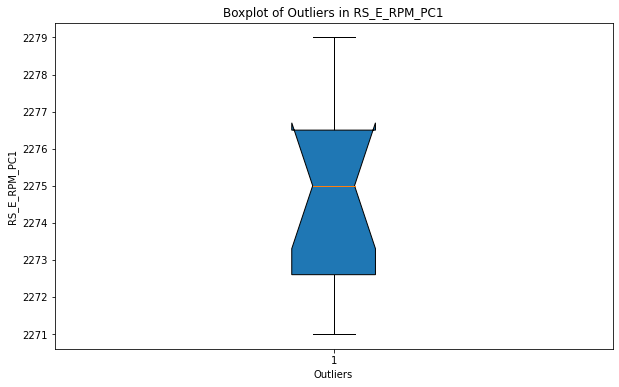

Anomalies detected in feature: RS_E_RPM_PC1
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
234519     11922726          172.0  2023-01-30  20:48:00  51.203907  4.428286   
239932     15937706          172.0  2023-02-01  12:09:18  51.191994  5.122915   
239933     12819340          172.0  2023-02-01  12:09:20  51.191921  5.122541   
239934      6109145          172.0  2023-02-01  12:09:28  51.192247  5.124394   
239935     16653483          172.0  2023-02-01  12:09:29  51.192160  5.123908   
239937      8898713          172.0  2023-02-01  12:09:48  51.192797  5.128420   
239938       683111          172.0  2023-02-01  12:09:50  51.192769  5.128216   
239939      6993050          172.0  2023-02-01  12:10:24  51.190278  5.135243   
239940     16662129          172.0  2023-02-01  12:10:28  51.189284  5.136153   
239941       683114          172.0  2023-02-01  12:10:38  51.187686  5.137640   
385385     16817882          172.0  2023-04-15  07:18:55  51.1875

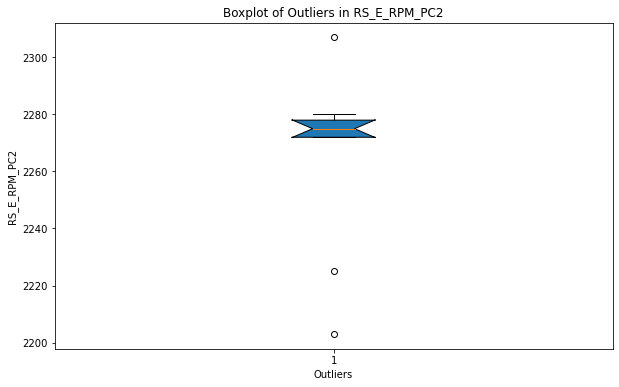

Anomalies detected in feature: RS_E_RPM_PC2
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
113052     11987228          102.0  2023-05-23  20:53:59  50.933003  3.638465   
113053     14238352          102.0  2023-05-23  20:54:18  50.934627  3.637786   
286235      6556855          172.0  2023-02-18  13:15:39  51.196473  4.434755   
286236     10098941          172.0  2023-02-18  13:15:55  51.195469  4.435570   
414836     10851685          172.0  2023-05-14  17:42:11  51.188823  5.136599   
414837     15810052          172.0  2023-05-14  17:42:17  51.188407  5.136981   
699558     17072392          174.0  2023-05-04  04:58:40  50.329040  4.406943   
699559     12461309          174.0  2023-05-04  04:58:47  50.329694  4.407094   
1003092       19894          194.0  2023-08-09  14:36:05  50.777208  3.874036   

         Distance  Time_elapsed     Speed  Prev_speed  ...  \
113052   0.004393          45.0  0.000351    0.000070  ...   
113053   0.001760    

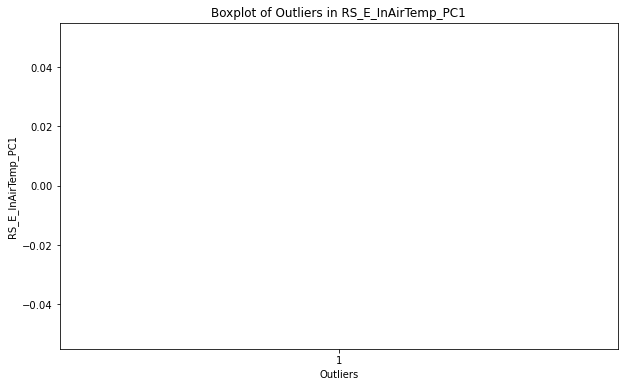

Anomalies detected in feature: RS_E_InAirTemp_PC1
Empty DataFrame
Columns: [Row_number, Mapped_veh_id, Dates, Time, Lat_x, Lon_x, Distance, Time_elapsed, Speed, Prev_speed, Acceleration, RS_E_InAirTemp_PC1, RS_E_InAirTemp_PC2, RS_E_OilPress_PC1, RS_E_OilPress_PC2, RS_E_RPM_PC1, RS_E_RPM_PC2, RS_E_WatTemp_PC1, RS_E_WatTemp_PC2, RS_T_OilTemp_PC1, RS_T_OilTemp_PC2, Repair, Breakdown, Mean_RS_E_RPM_PC1, Mean_RS_E_RPM_PC2, Combined_Mean_RS_E_RPM, Mean_RS_E_OilPress_PC1, Mean_RS_E_OilPress_PC2, Combined_Mean_RS_E_OilPress, Mean_RS_E_InAirTemp_PC1, Mean_RS_E_InAirTemp_PC2, Combined_Mean_RS_E_InAirTemp, Mean_RS_E_WatTemp_PC1, Mean_RS_E_WatTemp_PC2, Combined_Mean_RS_E_WatTemp, Air_Temp_Status_PC1, Air_Temp_Status_PC2, Water_Temp_Status_PC1, Water_Temp_Status_PC2, Oil_Temp_Status_PC1, Oil_Temp_Status_PC2, Global_Vehicle_Status, Vehicule_Status_PC1, Vehicule_Status_PC2]
Index: []

[0 rows x 44 columns]
Outlier DataFrame: Empty DataFrame
Columns: [Row_number, Mapped_veh_id, Dates, Time, Lat_x, Lon

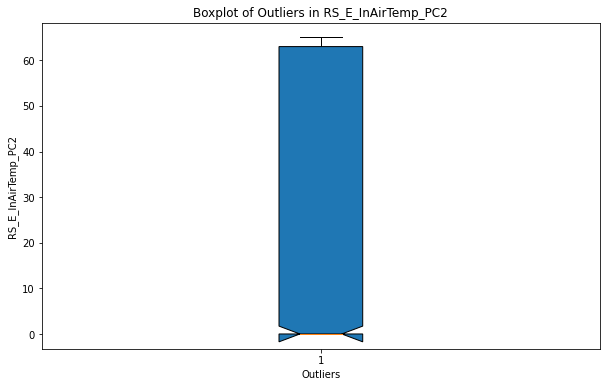

Anomalies detected in feature: RS_E_InAirTemp_PC2
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
986          398010          102.0  2023-01-23  22:36:10  50.855277  3.606160   
987          696044          102.0  2023-01-23  22:36:19  50.855056  3.605874   
1020       12091726          102.0  2023-01-24  01:08:34  50.855096  3.605879   
1021       10885528          102.0  2023-01-24  01:08:40  50.855386  3.606330   
1028       16104950          102.0  2023-01-24  01:11:15  50.855067  3.605902   
...             ...            ...         ...       ...        ...       ...   
1174552    16185663          123.0  2023-05-31  21:41:23  51.189839  5.110763   
1174553    10014741          123.0  2023-05-31  21:41:43  51.189835  5.110754   
1174561     7534655          123.0  2023-05-31  21:48:07  51.190271  5.113277   
1175614     1572242          123.0  2023-06-01  21:41:11  51.190146  5.112567   
1175615     4517281          123.0  2023-06-01  21:41:24  5

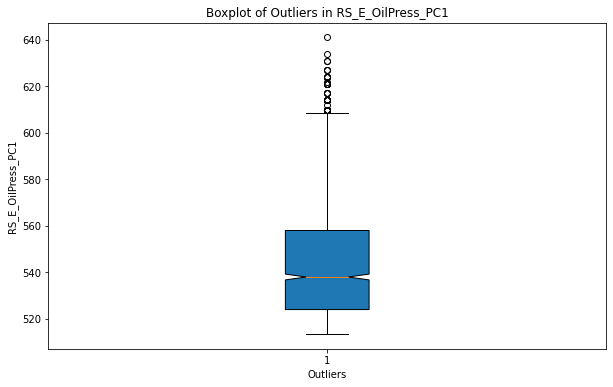

Anomalies detected in feature: RS_E_OilPress_PC1
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
5859       12884338          102.0  2023-01-27  02:13:47  50.774456  3.872824   
5860        3681326          102.0  2023-01-27  02:13:58  50.774051  3.872647   
5861        9359520          102.0  2023-01-27  02:14:47  50.774440  3.872834   
5862        8963628          102.0  2023-01-27  02:14:59  50.774035  3.872664   
5863       14997747          102.0  2023-01-27  02:15:47  50.774447  3.872826   
...             ...            ...         ...       ...        ...       ...   
1132310     4536812          123.0  2023-03-19  18:51:02  51.190774  5.113423   
1132318    15100596          123.0  2023-03-19  18:57:45  51.189300  5.107043   
1132321    13953899          123.0  2023-03-19  18:59:59  51.188205  5.101069   
1132322    14814790          123.0  2023-03-19  19:00:09  51.188269  5.101432   
1132331     3242005          123.0  2023-03-19  19:08:03  51

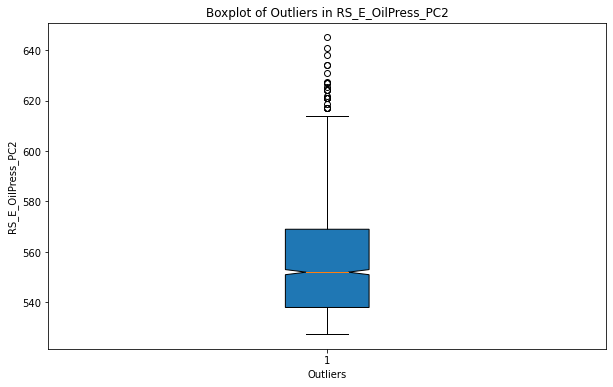

Anomalies detected in feature: RS_E_OilPress_PC2
         Row_number  Mapped_veh_id       Dates      Time      Lat_x     Lon_x  \
5859       12884338          102.0  2023-01-27  02:13:47  50.774456  3.872824   
5860        3681326          102.0  2023-01-27  02:13:58  50.774051  3.872647   
5861        9359520          102.0  2023-01-27  02:14:47  50.774440  3.872834   
5862        8963628          102.0  2023-01-27  02:14:59  50.774035  3.872664   
5863       14997747          102.0  2023-01-27  02:15:47  50.774447  3.872826   
...             ...            ...         ...       ...        ...       ...   
1132308      945673          123.0  2023-03-19  18:48:58  51.190817  5.113426   
1132309     5283967          123.0  2023-03-19  18:50:02  51.190781  5.113391   
1132318    15100596          123.0  2023-03-19  18:57:45  51.189300  5.107043   
1132321    13953899          123.0  2023-03-19  18:59:59  51.188205  5.101069   
1132322    14814790          123.0  2023-03-19  19:00:09  51

In [102]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the DataFrame
df = asymptoms_df

# Select features related to cooling systems
cooling_features = ['RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1', 'RS_E_OilPress_PC2']

# Initialize an empty list to store the generated CSV file names
outlier_csvs = []

# Detect anomalies using statistical methods
for feature in cooling_features:
    # Calculate Z-scores
    z_scores = (df[feature] - df[feature].mean()) / df[feature].std()

    # Identify outliers based on Z-score thresholds
    outliers = df[abs(z_scores) > 3]

    # Create a separate DataFrame for each outlier and assign a unique name
    outlier_df = pd.DataFrame(outliers)
    outlier_df_name = f'anomalies_{feature}.csv'

    # Generate boxplot to visualize deviation of outliers
    plt.figure(figsize=(10, 6))
    plt.boxplot(outliers[feature], patch_artist=True, notch=True)
    plt.xlabel('Outliers')
    plt.ylabel(feature)
    plt.title('Boxplot of Outliers in ' + feature)
    plt.show()

    # Report anomalies and save the outlier DataFrame
    print("Anomalies detected in feature:", feature)
    print(outliers)
    print("Outlier DataFrame:", outlier_df)
    print("Saving outlier DataFrame to:", outlier_df_name)

    # Save the outlier DataFrame to a separate CSV file and add it to the list
    outlier_df.to_csv(outlier_df_name, index=False)
    outlier_csvs.append(outlier_df_name)

# Print the list of all generated CSV files
print("List of all generated CSV files:")
for csv_file in outlier_csvs:
    print(csv_file)


In [82]:
# Initialize an empty list to store the loaded DataFrames
loaded_dfs = []

# Load each CSV file into a DataFrame and append it to the list
for csv_file in outlier_csvs:
    loaded_df = pd.read_csv(csv_file)
    loaded_dfs.append(loaded_df)

# Combine the loaded DataFrames into a single DataFrame
combined_df = pd.concat(loaded_dfs)

# Count the occurrences of each train ID (Mapped_veh_id)
train_counts = combined_df['Mapped_veh_id'].value_counts()

# Sort the train counts in descending order
sorted_counts = train_counts.sort_values(ascending=False)

# Identify the top 5 trains with the most anomalies
top_5_trains = sorted_counts.index[:5]

print("Top 5 trains with the most anomalies:")
for train_id in top_5_trains:
    print(f"Train ID: {train_id} - Count: {train_counts[train_id]}")
    
    
# Convert the 'Dates' column to datetime format
combined_df['Dates'] = pd.to_datetime(combined_df['Dates'])

# Create a pivot table to summarize the number of anomalies per day and train ID
pivot_table = combined_df.pivot_table(index='Dates', columns='Mapped_veh_id', values='RS_E_RPM_PC1', aggfunc='count')

# Fill in missing values with 0
pivot_table.fillna(0, inplace=True)

# Print the pivot table
print("Number of anomalies per day for each train:")
print(pivot_table)

Top 5 trains with the most anomalies:
Train ID: 172.0 - Count: 2010
Train ID: 174.0 - Count: 1836
Train ID: 102.0 - Count: 1482
Train ID: 194.0 - Count: 1136
Train ID: 107.0 - Count: 532
Number of anomalies per day for each train:
Mapped_veh_id  102.0  107.0  123.0  172.0  174.0  194.0
Dates                                                  
2023-01-23       2.0    0.0    9.0    8.0    0.0    0.0
2023-01-24       9.0    0.0    1.0    5.0    0.0   31.0
2023-01-25       1.0    0.0    4.0   16.0    2.0   19.0
2023-01-26       3.0    0.0    0.0   26.0    0.0   21.0
2023-01-27      19.0    0.0    0.0    7.0    0.0   20.0
...              ...    ...    ...    ...    ...    ...
2023-09-08       0.0    1.0    0.0   46.0    4.0    0.0
2023-09-10       0.0   11.0    0.0    0.0    0.0    0.0
2023-09-11       0.0   12.0    0.0   32.0    0.0    0.0
2023-09-12       5.0    0.0    0.0    0.0   30.0    0.0
2023-09-13       0.0    0.0    0.0    2.0    0.0    0.0

[223 rows x 6 columns]


In [110]:
# Create an empty list to store the train ID and anomaly count information
train_anomaly_info = []

# Load each CSV file into a DataFrame and append it to the list
for csv_file in outlier_csvs:
    loaded_df = pd.read_csv(csv_file)
    loaded_dfs.append(loaded_df)

# Combine the loaded DataFrames into a single DataFrame
combined_df = pd.concat(loaded_dfs)

# Count the occurrences of each train ID (Mapped_veh_id)
train_counts = combined_df['Mapped_veh_id'].value_counts()

# Sort the train counts in descending order
sorted_counts = train_counts.sort_values(ascending=False)

# Identify the top 5 trains with the most anomalies
top_5_trains = sorted_counts.index[:5]

# Extract and store the train ID and anomaly count information for the top 5 trains
for train_id in top_5_trains:
    train_anomaly_info.append({
        "Train ID": train_id,
        "Anomaly Count": train_counts[train_id]
    })


# Check if the file exists
if os.path.exists(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\Top5_Trains.csv"):
    # Delete the existing file
    os.remove(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\Top5_Trains.csv")

# Export the DataFrame to a CSV file
train_anomaly_df.to_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\Top5_Trains.csv", sep=',')


In [107]:
# Create a file that will count the number of anomaies per day. 

# Convert the 'Dates' column to datetime format
combined_df['Dates'] = pd.to_datetime(combined_df['Dates'])

# Group the DataFrame by 'Dates' and 'Mapped_veh_id'
grouped_anomaly_df = combined_df.groupby(['Dates', 'Mapped_veh_id'])

# Count the number of anomalies for each group
count_anomaly_df = grouped_anomaly_df.size().reset_index()

# Print the DataFrame
print("Number of anomalies per day for each train DataFrame:")
count_anomaly_df


# Check if the file exists
if os.path.exists(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\Number_anomalies_pertrain_perday.csv"):
    # Delete the existing file
    os.remove(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\Number_anomalies_pertrain_perday.csv")

# Export the DataFrame to a CSV file
train_anomaly_df.to_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\Number_anomalies_pertrain_perday.csv", sep=',')

Number of anomalies per day for each train DataFrame:


In [85]:
pivot_table

Mapped_veh_id,102.0,107.0,123.0,172.0,174.0,194.0
Dates,,,,,,
2023-01-23,2.0,0.0,9.0,8.0,0.0,0.0
2023-01-24,9.0,0.0,1.0,5.0,0.0,31.0
2023-01-25,1.0,0.0,4.0,16.0,2.0,19.0
2023-01-26,3.0,0.0,0.0,26.0,0.0,21.0
2023-01-27,19.0,0.0,0.0,7.0,0.0,20.0
...,...,...,...,...,...,...
2023-09-08,0.0,1.0,0.0,46.0,4.0,0.0
2023-09-10,0.0,11.0,0.0,0.0,0.0,0.0
2023-09-11,0.0,12.0,0.0,32.0,0.0,0.0


This create one dataset with all the anomalies. 

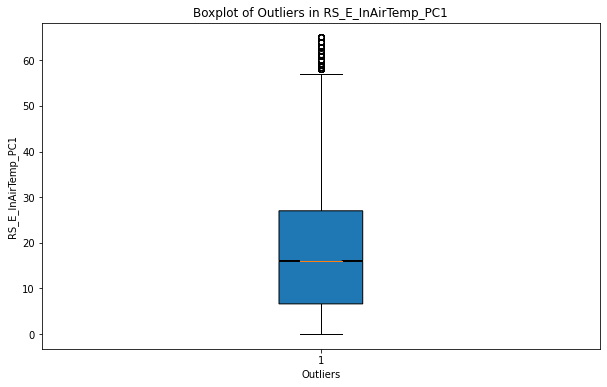

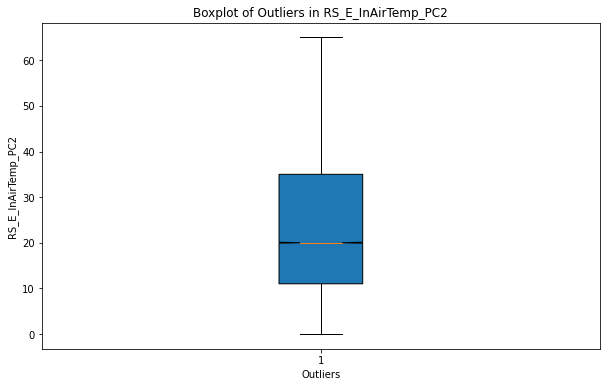

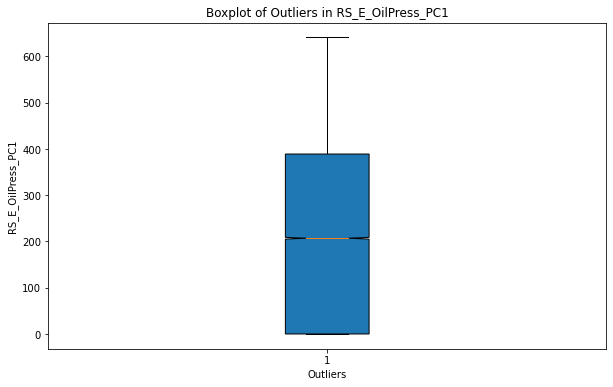

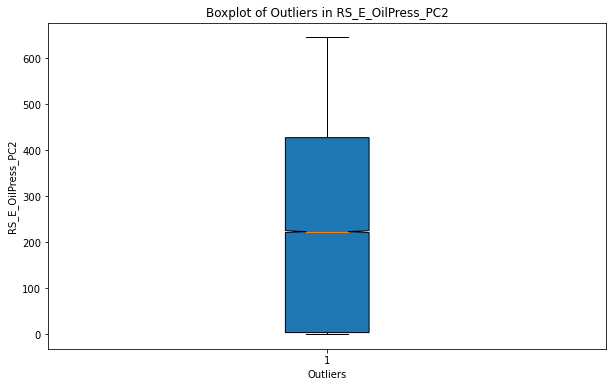

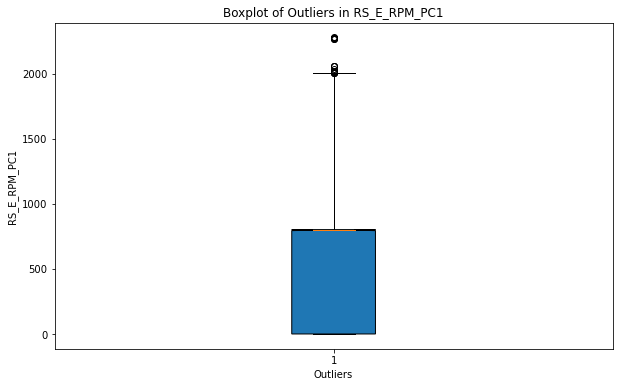

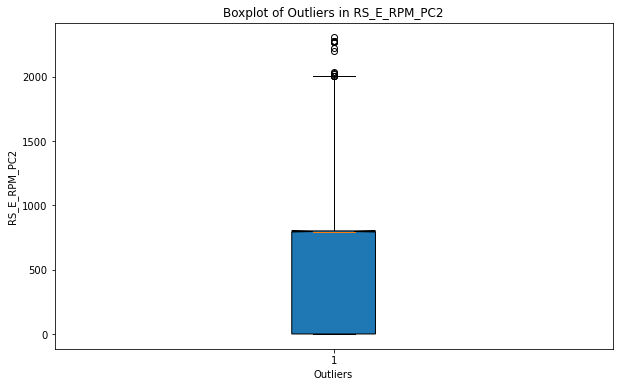

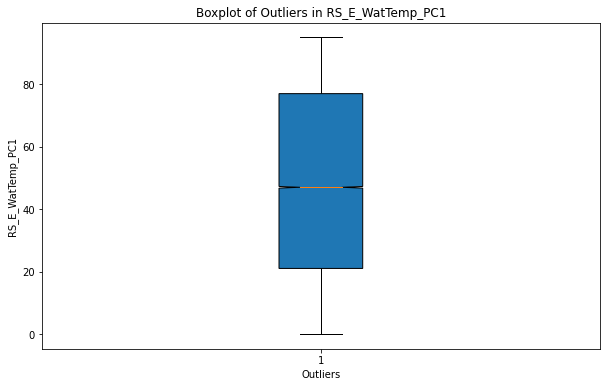

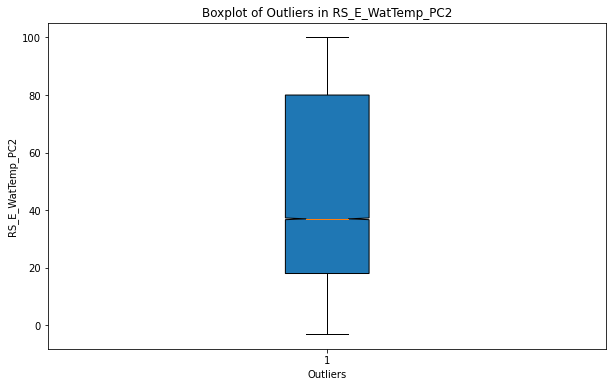

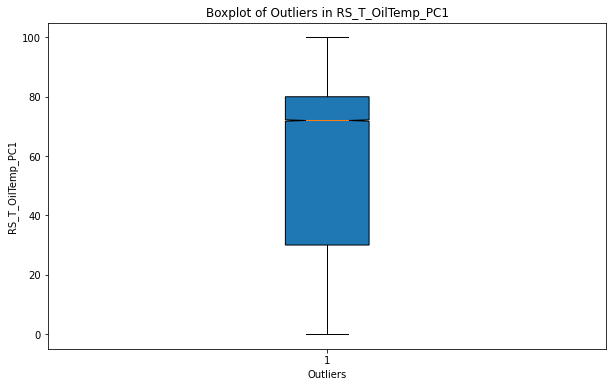

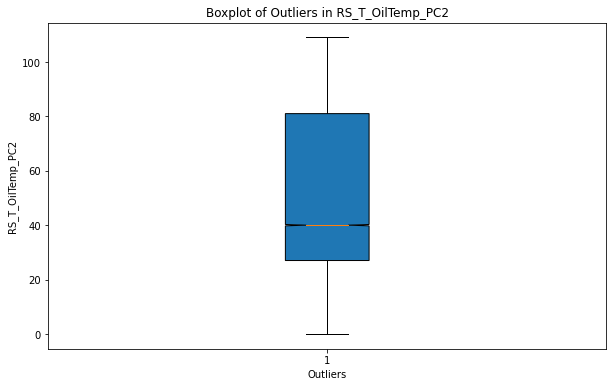

Anomalies detected:
        Row_number  Mapped_veh_id       Dates      Time  RS_E_InAirTemp_PC1  \
0                1          102.0  2023-01-23  22:36:10                 0.0   
1                2          102.0  2023-01-23  22:36:19                 0.0   
2                3          102.0  2023-01-24  01:08:34                 0.0   
3                4          102.0  2023-01-24  01:08:40                 0.0   
4                5          102.0  2023-01-24  01:11:15                 0.0   
...            ...            ...         ...       ...                 ...   
109877      109878          123.0  2023-05-31  02:02:27                15.0   
109878      109879          123.0  2023-05-31  02:03:26                15.0   
109879      109880          123.0  2023-05-31  02:04:27                15.0   
109880      109881          123.0  2023-05-31  02:05:30                15.0   
109881      109882          123.0  2023-05-31  02:06:31                15.0   

        RS_E_InAirTemp_PC2  RS_

In [104]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the DataFrame
df = asymptoms_df

# Select features related to cooling systems
cooling_features = ['RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2']

# Initialize empty DataFrame to store anomalies
anomaly_df = pd.DataFrame(columns=['Row_number', 'Mapped_veh_id', 'Dates', 'Time'] + cooling_features)

# Detect anomalies using statistical methods
for feature in cooling_features:
    # Calculate Z-scores
    z_scores = (df[feature] - df[feature].mean()) / df[feature].std()

    # Identify outliers based on Z-score thresholds
    outliers = df[abs(z_scores) > 3]

    # Append outlier data to the anomaly DataFrame
    anomaly_df = pd.concat([anomaly_df, outliers[['Mapped_veh_id', 'Dates', 'Time'] + [feature for feature in cooling_features]]], ignore_index=True)

# Add row numbers to the anomaly DataFrame
anomaly_df['Row_number'] = range(1, len(anomaly_df) + 1)

# Generate boxplots to visualize deviation of outliers
for feature in cooling_features:
    plt.figure(figsize=(10, 6))
    plt.boxplot(anomaly_df[feature], patch_artist=True, notch=True)
    plt.xlabel('Outliers')
    plt.ylabel(feature)
    plt.title('Boxplot of Outliers in ' + feature)
    plt.show()

# Report anomalies
print("Anomalies detected:")
print(anomaly_df)


In [105]:
anomaly_df

,Row_number,Mapped_veh_id,Dates,Time,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
0,1,102.0,2023-01-23,22:36:10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,75.666667,81.666667
1,2,102.0,2023-01-23,22:36:19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,81.000000,81.000000
2,3,102.0,2023-01-24,01:08:34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.000000,53.000000
3,4,102.0,2023-01-24,01:08:40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.000000,53.000000
4,5,102.0,2023-01-24,01:11:15,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.000000,54.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109877,109878,123.0,2023-05-31,02:02:27,15.0,19.0,393.0,414.0,797.0,797.0,47.0,49.0,41.000000,42.000000
109878,109879,123.0,2023-05-31,02:03:26,15.0,19.0,396.0,414.0,805.0,801.0,47.0,50.0,41.000000,42.000000
109879,109880,123.0,2023-05-31,02:04:27,15.0,19.0,389.0,400.0,798.0,792.0,47.0,50.0,41.000000,44.000000
109880,109881,123.0,2023-05-31,02:05:30,15.0,19.0,386.0,393.0,797.0,791.0,47.0,51.0,41.000000,44.000000


In [65]:
anomaly_df['Mapped_veh_id'].value_counts().sort_values(ascending=False)

Mapped_veh_id
172.0    37366
194.0    28800
102.0    18620
123.0    11154
174.0    10133
107.0     3809
Name: count, dtype: int64

In [106]:
# Export to csv & save the file
anomaly_df.to_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\SNCB_ANOMALY.csv", sep = ';')

# Move the file in the new folder structure 
import os
# Check if the file exists
if os.path.exists(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\SNCB_ANOMALY.csv"):
    # Delete the existing file
    os.remove(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\SNCB_ANOMALY.csv")
    os.rename(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\SNCB_ANOMALY.csv", r"C:\\Users\Florian\COURS_ULB\Data_folder_output\SNCB_ANOMALY.csv")

# read the file from there
df = pd.read_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\SNCB_ANOMALY.csv", sep = ';')
df

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
0,0,1,102.0,2023-01-23,22:36:10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,75.666667,81.666667
1,1,2,102.0,2023-01-23,22:36:19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,81.000000,81.000000
2,2,3,102.0,2023-01-24,01:08:34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.000000,53.000000
3,3,4,102.0,2023-01-24,01:08:40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.000000,53.000000
4,4,5,102.0,2023-01-24,01:11:15,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.000000,54.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109877,109877,109878,123.0,2023-05-31,02:02:27,15.0,19.0,393.0,414.0,797.0,797.0,47.0,49.0,41.000000,42.000000
109878,109878,109879,123.0,2023-05-31,02:03:26,15.0,19.0,396.0,414.0,805.0,801.0,47.0,50.0,41.000000,42.000000
109879,109879,109880,123.0,2023-05-31,02:04:27,15.0,19.0,389.0,400.0,798.0,792.0,47.0,50.0,41.000000,44.000000
109880,109880,109881,123.0,2023-05-31,02:05:30,15.0,19.0,386.0,393.0,797.0,791.0,47.0,51.0,41.000000,44.000000


In [24]:
# read the file from there
df_xy = pd.read_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\merged_direction_smoothslope_smoothelevation_smoothkph_xy_dist_full_dataset.csv", sep = ';')
df_xy

,att1,mapped_veh_id,timestamps_UTC,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,...,RS_T_OilTemp_PC2,x,y,distance,speed_kph,etopo1_elevation,slope,x-8,y-8,angle
0,0,181.0,2023-08-01 03:44:12,50.769818,3.872114,27.0,23.0,255.0,238.0,794.0,...,77.0,114967.003929,162264.108892,49.524119,20.736387,30.0,0.000000,114965.519257,162263.618225,71.711861
1,1,143.0,2023-08-01 06:36:29,51.039993,3.693429,33.0,32.0,272.0,324.0,802.0,...,74.0,102635.784313,192417.230242,47.822647,12.223079,6.0,0.000000,102632.954012,192414.508036,46.115281
2,2,183.0,2023-08-24 06:53:54,50.742203,3.602035,31.0,33.0,234.0,182.0,799.0,...,87.0,95884.316392,159354.254143,41.991443,31.675001,38.0,-0.000552,95884.882226,159352.312666,343.751468
3,3,177.0,2023-08-01 13:53:38,50.930914,5.327132,35.0,38.0,220.0,244.0,794.0,...,82.0,217371.804599,180503.158752,45.748298,40.815730,37.0,0.005045,216571.609019,180811.644716,111.082310
4,4,143.0,2023-08-24 07:02:30,51.180773,3.575259,41.0,34.0,227.0,282.0,806.0,...,79.0,94515.418096,208159.920637,44.023801,33.623397,6.0,0.000000,94515.458229,208163.024343,180.740834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17679268,17679268,180.0,2023-05-28 19:28:59,50.919864,3.791125,40.0,36.0,238.0,238.0,800.0,...,92.0,109383.755416,178996.103713,45.337188,41.622837,44.4,-0.041716,110520.993886,176510.278812,335.416409
17679269,17679269,180.0,2023-05-28 19:54:41,51.035243,3.710695,41.0,31.0,244.0,241.0,790.0,...,87.0,103842.064033,191877.886677,0.147721,27.936173,10.0,-0.002464,105731.605895,191572.336594,279.185553
17679270,17679270,122.0,2023-05-28 20:23:20,51.015686,3.775316,52.0,42.0,3.0,3.0,0.0,...,82.0,108357.262690,189664.223867,43.166744,11.334497,11.0,-0.000139,107918.568805,189900.535300,118.310034
17679271,17679271,177.0,2023-05-28 20:46:00,51.189586,5.109380,27.0,38.0,417.0,469.0,1441.0,...,80.0,201777.661576,209103.271071,43.398965,54.969777,27.0,0.000366,201735.980511,209093.197814,76.413577


In [25]:
df_xy.columns

Index(['att1', 'mapped_veh_id', 'timestamps_UTC', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle'],
      dtype='object')

In [26]:
# Select columns
df_xy = df_xy[['att1', 'mapped_veh_id', 'timestamps_UTC', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle']]

df_xy = df_xy.rename(columns={"att1": "Row_number", "mapped_veh_id": "Mapped_veh_id"})

In [27]:
df_xy.columns

Index(['Row_number', 'Mapped_veh_id', 'timestamps_UTC', 'lat', 'lon',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'x', 'y',
       'distance', 'speed_kph', 'etopo1_elevation', 'slope', 'x-8', 'y-8',
       'angle'],
      dtype='object')

In [28]:
df_xy.iloc[109881]

Row_number                         109881
Mapped_veh_id                       197.0
timestamps_UTC        2023-04-02 17:49:41
lat                             50.056889
lon                               4.49239
RS_E_InAirTemp_PC1                   24.0
RS_E_InAirTemp_PC2                   23.0
RS_E_OilPress_PC1                   220.0
RS_E_OilPress_PC2                   300.0
RS_E_RPM_PC1                        801.0
RS_E_RPM_PC2                        799.0
RS_E_WatTemp_PC1                     77.0
RS_E_WatTemp_PC2                     66.0
RS_T_OilTemp_PC1                     74.0
RS_T_OilTemp_PC2                     70.0
x                           158854.368456
y                            82854.660953
distance                         45.65485
speed_kph                       15.280088
etopo1_elevation                    209.0
slope                            0.000001
x-8                         158852.256831
y-8                          82854.156896
angle                           76

In [29]:
# read the file from there
df = pd.read_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_output\SNCB_ANOMALY.csv", sep = ';')
df

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
0,0,1,102.0,2023-01-23,22:36:10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,75.666667,81.666667
1,1,2,102.0,2023-01-23,22:36:19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,81.000000,81.000000
2,2,3,102.0,2023-01-24,01:08:34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.000000,53.000000
3,3,4,102.0,2023-01-24,01:08:40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.000000,53.000000
4,4,5,102.0,2023-01-24,01:11:15,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.000000,54.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109877,109877,109878,123.0,2023-05-31,02:02:27,15.0,19.0,393.0,414.0,797.0,797.0,47.0,49.0,41.000000,42.000000
109878,109878,109879,123.0,2023-05-31,02:03:26,15.0,19.0,396.0,414.0,805.0,801.0,47.0,50.0,41.000000,42.000000
109879,109879,109880,123.0,2023-05-31,02:04:27,15.0,19.0,389.0,400.0,798.0,792.0,47.0,50.0,41.000000,44.000000
109880,109880,109881,123.0,2023-05-31,02:05:30,15.0,19.0,386.0,393.0,797.0,791.0,47.0,51.0,41.000000,44.000000


In [30]:
# Merged to extract the localisation data from Steve
new_df = pd.merge(df, df_xy, how='left', on="Row_number")
new_df

,Unnamed: 0,Row_number,Mapped_veh_id_x,Dates,Time,RS_E_InAirTemp_PC1_x,RS_E_InAirTemp_PC2_x,RS_E_OilPress_PC1_x,RS_E_OilPress_PC2_x,RS_E_RPM_PC1_x,...,RS_T_OilTemp_PC2_y,x,y,distance,speed_kph,etopo1_elevation,slope,x-8,y-8,angle
0,0,1,102.0,2023-01-23,22:36:10,0.0,0.0,0.0,0.0,0.0,...,74.0,102635.784313,192417.230242,47.822647,12.223079,6.0,0.000000e+00,102632.954012,192414.508036,46.115281
1,1,2,102.0,2023-01-23,22:36:19,0.0,0.0,0.0,0.0,0.0,...,87.0,95884.316392,159354.254143,41.991443,31.675001,38.0,-5.522746e-04,95884.882226,159352.312666,343.751468
2,2,3,102.0,2023-01-24,01:08:34,0.0,0.0,0.0,0.0,0.0,...,82.0,217371.804599,180503.158752,45.748298,40.815730,37.0,5.045184e-03,216571.609019,180811.644716,111.082310
3,3,4,102.0,2023-01-24,01:08:40,0.0,0.0,0.0,0.0,0.0,...,79.0,94515.418096,208159.920637,44.023801,33.623397,6.0,0.000000e+00,94515.458229,208163.024343,180.740834
4,4,5,102.0,2023-01-24,01:11:15,0.0,0.0,0.0,0.0,0.0,...,84.0,154946.602610,121484.911333,5.089610,0.473344,117.0,0.000000e+00,154947.161947,121487.303317,193.161450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109877,109877,109878,123.0,2023-05-31,02:02:27,15.0,19.0,393.0,414.0,797.0,...,44.0,156351.876456,121104.607378,45.467667,16.950844,111.6,7.166752e-04,156167.858295,121127.734748,97.163365
109878,109878,109879,123.0,2023-05-31,02:03:26,15.0,19.0,396.0,414.0,805.0,...,87.0,108453.981124,180999.714444,40.687430,49.487340,31.2,-4.657739e-02,109430.655559,178913.372648,334.914403
109879,109879,109880,123.0,2023-05-31,02:04:27,15.0,19.0,389.0,400.0,798.0,...,84.0,103757.870873,191946.262573,47.885366,28.347645,10.2,3.483892e-03,105834.781615,191568.958491,280.296406
109880,109880,109881,123.0,2023-05-31,02:05:30,15.0,19.0,386.0,393.0,797.0,...,70.0,158854.368456,82854.660953,45.654850,15.280088,209.0,8.209882e-07,158852.256831,82854.156896,76.574412


In [32]:
new_df.columns

Index(['Unnamed: 0', 'Row_number', 'Mapped_veh_id_x', 'Dates', 'Time',
       'RS_E_InAirTemp_PC1_x', 'RS_E_InAirTemp_PC2_x', 'RS_E_OilPress_PC1_x',
       'RS_E_OilPress_PC2_x', 'RS_E_RPM_PC1_x', 'RS_E_RPM_PC2_x',
       'RS_E_WatTemp_PC1_x', 'RS_E_WatTemp_PC2_x', 'RS_T_OilTemp_PC1_x',
       'RS_T_OilTemp_PC2_x', 'Mapped_veh_id_y', 'timestamps_UTC', 'lat', 'lon',
       'RS_E_InAirTemp_PC1_y', 'RS_E_InAirTemp_PC2_y', 'RS_E_OilPress_PC1_y',
       'RS_E_OilPress_PC2_y', 'RS_E_RPM_PC1_y', 'RS_E_RPM_PC2_y',
       'RS_E_WatTemp_PC1_y', 'RS_E_WatTemp_PC2_y', 'RS_T_OilTemp_PC1_y',
       'RS_T_OilTemp_PC2_y', 'x', 'y', 'distance', 'speed_kph',
       'etopo1_elevation', 'slope', 'x-8', 'y-8', 'angle'],
      dtype='object')

In [34]:
new_df = new_df[['Row_number', 'Mapped_veh_id_x', 'Dates', 'Time',
       'RS_E_InAirTemp_PC1_x', 'RS_E_InAirTemp_PC2_x', 'RS_E_OilPress_PC1_x',
       'RS_E_OilPress_PC2_x', 'RS_E_RPM_PC1_x', 'RS_E_RPM_PC2_x',
       'RS_E_WatTemp_PC1_x', 'RS_E_WatTemp_PC2_x', 'RS_T_OilTemp_PC1_x',
       'RS_T_OilTemp_PC2_x', 'timestamps_UTC', 'lat', 'lon',
        'x', 'y', 'distance', 'speed_kph'
       ]]

new_df = new_df.rename(columns={"Mapped_veh_id_x": "Mapped_veh_id",
                               'RS_E_InAirTemp_PC1_x':'RS_E_InAirTemp_PC1',
                               'RS_E_InAirTemp_PC2_x': 'RS_E_InAirTemp_PC2',
                               'RS_E_OilPress_PC1_x' : 'RS_E_OilPress_PC1',
                               'RS_E_OilPress_PC2_x' : 'RS_E_OilPress_PC2',
                               'RS_E_RPM_PC1_x' : 'RS_E_RPM_PC1',
                               'RS_E_RPM_PC2_x' : 'RS_E_RPM_PC2',
                               'RS_E_WatTemp_PC1_x' : 'RS_E_WatTemp_PC1',
                               'RS_E_WatTemp_PC2_x' : 'RS_E_WatTemp_PC2',
                               'RS_T_OilTemp_PC1_x' : 'RS_T_OilTemp_PC1',
                               'RS_T_OilTemp_PC2_x' : 'RS_T_OilTemp_PC2'})
# Export to csv & save the file
new_df.to_csv(r"C:\\Users\Florian\COURS_ULB\Data_folder_input\SNCB_ANOMALY_V3.csv", sep = ';')
new_df

,Row_number,Mapped_veh_id,Dates,Time,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,...,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,timestamps_UTC,lat,lon,x,y,distance,speed_kph
0,1,102.0,2023-01-23,22:36:10,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,75.666667,81.666667,2023-08-01 06:36:29,51.039993,3.693429,102635.784313,192417.230242,47.822647,12.223079
1,2,102.0,2023-01-23,22:36:19,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,81.000000,81.000000,2023-08-24 06:53:54,50.742203,3.602035,95884.316392,159354.254143,41.991443,31.675001
2,3,102.0,2023-01-24,01:08:34,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,49.000000,53.000000,2023-08-01 13:53:38,50.930914,5.327132,217371.804599,180503.158752,45.748298,40.815730
3,4,102.0,2023-01-24,01:08:40,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,49.000000,53.000000,2023-08-24 07:02:30,51.180773,3.575259,94515.418096,208159.920637,44.023801,33.623397
4,5,102.0,2023-01-24,01:11:15,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,50.000000,54.000000,2023-08-24 07:06:16,50.404240,4.438329,154946.602610,121484.911333,5.089610,0.473344
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109877,109878,123.0,2023-05-31,02:02:27,15.0,19.0,393.0,414.0,797.0,797.0,...,49.0,41.000000,42.000000,2023-04-02 15:20:26,50.400808,4.458091,156351.876456,121104.607378,45.467667,16.950844
109878,109879,123.0,2023-05-31,02:03:26,15.0,19.0,396.0,414.0,805.0,801.0,...,50.0,41.000000,42.000000,2023-04-02 17:33:56,50.937809,3.777676,108453.981124,180999.714444,40.687430,49.487340
109879,109880,123.0,2023-05-31,02:04:27,15.0,19.0,389.0,400.0,798.0,792.0,...,50.0,41.000000,44.000000,2023-04-02 17:45:45,51.035851,3.709486,103757.870873,191946.262573,47.885366,28.347645
109880,109881,123.0,2023-05-31,02:05:30,15.0,19.0,386.0,393.0,797.0,791.0,...,51.0,41.000000,44.000000,2023-04-02 17:49:41,50.056889,4.492390,158854.368456,82854.660953,45.654850,15.280088


In [50]:
# Check for missing values
missing_values_df = df.isnull().sum()
print("Missing Values:")
print(missing_values_df)

# Check for outliers
from scipy.stats import zscore

for feature in asymptoms_df.columns:
    z_scores = zscore(asymptoms_df[feature])
    outliers = (abs(z_scores) > 3).sum()

    print(f"Outliers in Feature: {feature}, Count: {outliers}")

Missing Values:
ID             0
Type           0
City           0
Place_Name     0
Company        0
Speciality     0
Coordinates    0
Latitude       0
Longitude      0
dtype: int64
Outliers in Feature: Row_number, Count: 0
Outliers in Feature: Mapped_veh_id, Count: 0


KeyboardInterrupt: 

In [68]:
# Assuming your breakdown dataset is stored in a variable named 'breakdown_df'
date_filter = breakdown_df['Dates'] == '2023-01-23'
time_filter = breakdown_df['Mapped_veh_id'] == 102.0
filtered_df = breakdown_df[date_filter & time_filter]
filtered_df

,Row_number,Mapped_veh_id,Dates,Time,Lat_x,Lon_x,Distance,Time_elapsed,Speed,Prev_speed,...,Combined_Mean_RS_E_RPM,Mean_RS_E_OilPress_PC1,Mean_RS_E_OilPress_PC2,Combined_Mean_RS_E_OilPress,Mean_RS_E_InAirTemp_PC1,Mean_RS_E_InAirTemp_PC2,Combined_Mean_RS_E_InAirTemp,Mean_RS_E_WatTemp_PC1,Mean_RS_E_WatTemp_PC2,Combined_Mean_RS_E_WatTemp
0,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,0.000000,0.0,0.000000,0.000000,...,848.5,210.0,210.0,210.0,17.0,17.0,17.5,78.0,80.0,79.0
1,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,0.000034,8.0,0.000015,0.000000,...,802.5,200.0,200.0,200.0,17.0,17.0,18.5,79.0,80.0,79.5
2,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,0.001314,21.0,0.000225,0.000015,...,805.5,193.0,207.0,200.0,19.0,19.0,19.5,80.0,81.0,80.5
3,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,0.000905,4.0,0.000815,0.000225,...,802.0,196.0,203.0,199.5,19.0,19.0,19.5,80.0,81.0,80.5
4,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,0.001219,29.0,0.000151,0.000815,...,801.0,200.0,203.0,201.5,19.0,19.0,20.0,80.0,82.0,81.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
887,6145604,102.0,2023-01-23,21:43:21,51.032705,3.737602,0.001358,12.0,0.000407,0.000023,...,868.5,189.0,193.0,191.0,30.0,30.0,24.0,80.0,86.0,83.0
888,408308,102.0,2023-01-23,21:44:09,51.032286,3.734844,0.002790,48.0,0.000209,0.000407,...,804.0,182.0,182.0,182.0,28.0,28.0,23.0,81.0,86.0,83.5
889,702154,102.0,2023-01-23,21:44:21,51.031827,3.733281,0.001629,12.0,0.000489,0.000209,...,800.0,186.0,182.0,184.0,28.0,28.0,23.0,81.0,86.0,83.5
890,5489223,102.0,2023-01-23,21:45:09,51.031445,3.730518,0.002789,48.0,0.000209,0.000489,...,802.5,186.0,182.0,184.0,26.0,26.0,21.5,80.0,83.0,81.5


# Machine Learning model

### First multiprocessing

Create Coordinates columns based on function

In [10]:
def get_coordinates(row):
    return (row['lat'], row['lon'])

In [11]:
import time
from pandarallel import pandarallel
pandarallel.initialize(progress_bar=True,nb_workers=5)

start = time.time()

df_test['Coordinates'] = df_test.parallel_apply(get_coordinates, axis=1)

end = time.time()
print(end - start)
df_test

,row_number,mapped_veh_id,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,Coordinates
5493376,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,17.0,18.0,210.0,210.0,858.0,839.0,78.0,80.0,71.0,79.0,"(51.0178637, 3.7690786)"
8969009,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,17.0,20.0,200.0,200.0,801.0,804.0,79.0,80.0,76.0,79.0,"(51.0178749, 3.7690464)"
13873566,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,193.0,207.0,803.0,808.0,80.0,81.0,79.0,81.0,"(51.0172078, 3.7701787)"
14994675,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,19.0,20.0,196.0,203.0,801.0,803.0,80.0,81.0,79.0,81.0,"(51.0169155, 3.7710357)"
11935795,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,200.0,203.0,795.0,807.0,80.0,82.0,79.0,79.0,"(51.0165029, 3.7721823)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1820536,1820536,197.0,2023-09-13,17:33:03,50.402693,4.450111,37.0,40.0,220.0,258.0,803.0,803.0,81.0,79.0,77.0,81.0,"(50.4026933, 4.4501105)"
17128255,17128255,197.0,2023-09-13,17:33:58,50.401657,4.452693,37.0,38.0,224.0,307.0,843.0,941.0,80.0,78.0,77.0,80.0,"(50.4016568, 4.4526928)"
15456252,15456252,197.0,2023-09-13,17:34:03,50.401830,4.452217,37.0,38.0,224.0,307.0,841.0,932.0,80.0,78.0,77.0,80.0,"(50.4018297, 4.4522175)"
7666957,7666957,197.0,2023-09-13,17:34:58,50.401057,4.455388,36.0,38.0,207.0,244.0,800.0,803.0,81.0,80.0,77.0,82.0,"(50.4010568, 4.4553885)"


In [13]:
def découper_dataset(df, chunk_size):
    # Crée une liste de DataFrames
    df_list = []
    for i in range(0, len(df), chunk_size):
        df_list.append(df[i:i + chunk_size])
    return df_list

def fusionner_datasets(df_list):
    # Fusionne les DataFrames en un seul DataFrame
    df_merged = pd.concat(df_list)
    return df_merged

# Définit le nombre de processus
processes = 5

# Définit la taille des chunks
chunk_size = 10000

df_list = découper_dataset(df, chunk_size)

In [14]:
def geomap_2(coordinates):
    import multiprocessing
    multiprocessing.current_process().daemon = False
    import reverse_geocoder as rg
    lattitude, longitude = coordinates
    coordinates = (lattitude, longitude)
    results = rg.search(coordinates)

    return results

### Second multiprocessing

In [15]:
import multiprocessing
pandarallel.initialize(progress_bar=True,nb_workers=5)
with multiprocessing.Pool(processes=processes) as pool:
    # define saving interval
    interval = 100000
    # Initialisez un compteur
    count = 0
    
    # Itère sur les données
    for x in df_list:
        start = time.time()       
        # Applique les fonctions `geomap_2()` 
        x['Region_List'] = x.Coordinates.parallel_apply(geomap_2)
        end = time.time()
        print(end - start)
        # Sauvegarde les données traitées
        if count % interval == 0:
            df_merged = fusionner_datasets(df_list)
            df_merged.to_csv(r"D:\\Etudes\Big Data\Data Mining\SNCB_DATA_TRAIN.csv", sep = ';')
            print(f"Les données traitées ont été sauvegardées à l'intervalle {interval}.")
        count += 1
        
df_merged = fusionner_datasets(df_list)
df_merged.to_csv(r"D:\\Etudes\Big Data\Data Mining\SNCB_DATA_TRAIN.csv", sep = ';')
print(f"Les données traitées ont été sauvegardées à l'intervalle.")

In [379]:
asymptoms_df.columns

Index(['Row_number', 'Mapped_veh_id', 'Dates', 'Time', 'Lat_x', 'Lon_x',
       'Distance', 'Time_elapsed', 'Speed', 'Prev_speed', 'Acceleration',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'Repair',
       'Breakdown', 'Air_Temp_Status_PC1', 'Air_Temp_Status_PC2',
       'Water_Temp_Status_PC1', 'Water_Temp_Status_PC2', 'Oil_Temp_Status_PC1',
       'Oil_Temp_Status_PC2', 'Global_Vehicle_Status', 'Vehicule_Status_PC1',
       'Vehicule_Status_PC2', 'Mean_RS_E_RPM_PC1', 'Mean_RS_E_RPM_PC2',
       'Combined_Mean_RS_E_RPM', 'Mean_RS_E_OilPress_PC1',
       'Mean_RS_E_OilPress_PC2', 'Combined_Mean_RS_E_OilPress',
       'Mean_RS_E_InAirTemp_PC1', 'Mean_RS_E_InAirTemp_PC2',
       'Combined_Mean_RS_E_InAirTemp', 'Mean_RS_E_WatTemp_PC1',
       'Mean_RS_E_WatTemp_PC2', 'Combined_Mean_RS_E_WatTemp'],
      dtype='obje

# Create the region list columns

In [49]:
df_merged['Region_List'] = df_merged['Region_List'].str.strip('[]')
df_merged['Region_List'] = df_merged['Region_List'].str.split(',')
df_merged

,Unnamed: 0.2,Unnamed: 0,row_number,mapped_veh_id,Dates,Time,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,...,rel_hum,precipitation,pressure,prev_lat,prev_lon,prev_time,distance,time_elapsed,Speed,Unnamed: 0.1
0,0,5493376,5493376,102.0,2023-01-23,07:25:08,51.017864,3.769079,17.0,18.0,...,96.0,0.0,1036.6,NaN,NaN,NaN,NaN,0.0,NaN,NaN
1,1,8969009,8969009,102.0,2023-01-23,07:25:16,51.017875,3.769046,17.0,20.0,...,96.0,0.0,1036.6,51.017864,3.769079,07:25:08,0.000034,8.0,0.000015,NaN
2,2,13873566,13873566,102.0,2023-01-23,07:25:37,51.017208,3.770179,19.0,20.0,...,96.0,0.0,1036.6,51.017875,3.769046,07:25:16,0.001314,21.0,0.000225,NaN
3,3,14994675,14994675,102.0,2023-01-23,07:25:41,51.016916,3.771036,19.0,20.0,...,96.0,0.0,1036.6,51.017208,3.770179,07:25:37,0.000905,4.0,0.000815,NaN
4,4,11935795,11935795,102.0,2023-01-23,07:26:10,51.016503,3.772182,19.0,21.0,...,96.0,0.0,1036.6,51.016916,3.771036,07:25:41,0.001219,29.0,0.000151,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,1176527,861607,861607,123.0,2023-06-08,02:08:37,50.935961,5.310076,20.0,25.0,...,NaN,NaN,NaN,50.935486,5.311176,02:07:37,0.001197,60.0,0.000072,151596.0
1176528,1176528,1551506,1551506,123.0,2023-06-08,02:09:37,50.936620,5.307362,21.0,25.0,...,NaN,NaN,NaN,50.935961,5.310076,02:08:37,0.002793,60.0,0.000168,151597.0
1176529,1176529,15755138,15755138,123.0,2023-06-08,02:10:38,50.936810,5.306624,22.0,25.0,...,NaN,NaN,NaN,50.936620,5.307362,02:09:37,0.000762,61.0,0.000045,151598.0
1176530,1176530,10779814,10779814,123.0,2023-06-08,02:11:38,50.936870,5.306676,27.0,30.0,...,NaN,NaN,NaN,50.936810,5.306624,02:10:38,0.000080,60.0,0.000005,151599.0


In [54]:
df_merged_1 = df_merged
# Création d'une liste de dictionnaires
list_of_dicts = []
for row in df_merged_1.itertuples():
    # Conversion des clés en entiers
    name_index = row.Region_List.index("name")+8
    end_name_index = row.Region_List.index("admin1")-4
    admin1_index = row.Region_List.index("admin1")+10
    end_admin1_index = row.Region_List.index("admin2")-4
    admin2_index = row.Region_List.index("admin2")+10
    end_admin2_index = row.Region_List.index("cc")-4

    dict = {
        "row_number": row.row_number,
        "lat": row.lat,
        "lon": row.lon,
        "name": row.Region_List[name_index:end_name_index],
        "admin1": row.Region_List[admin1_index:end_admin1_index],
        "admin2": row.Region_List[admin2_index:end_admin2_index],
    }
    list_of_dicts.append(dict)
# Création d'un DataFrame à partir de la liste de dictionnaires
df_temp = df_merged_1
df_temp = pd.DataFrame(list_of_dicts)

# Insertion des nouvelles colonnes
#df107.insert(0, "name", df_temp["name"])
#df107.insert(1, "admin1", df_temp["admin1"])
#df107.insert(2, "admin2", df_temp["admin2"])


# Affichage du DataFrame
df_temp

,row_number,lat,lon,name,admin1,admin2
0,7231272,50.400542,4.459018,Charleroi,Wallonia,Province du Hainaut
1,7049287,50.400601,4.458995,Charleroi,Wallonia,Province du Hainaut
2,13859242,50.400400,4.459309,Charleroi,Wallonia,Province du Hainaut
3,9359246,50.400548,4.458946,Charleroi,Wallonia,Province du Hainaut
4,9346510,50.400371,4.459704,Charleroi,Wallonia,Province du Hainaut
...,...,...,...,...,...,...
413670,12546120,51.013760,3.779578,Melle,Flanders,Provincie Oost-Vlaanderen
413671,13428226,51.013759,3.779588,Melle,Flanders,Provincie Oost-Vlaanderen
413672,5820475,51.013762,3.779574,Melle,Flanders,Provincie Oost-Vlaanderen
413673,3001902,51.013464,3.780101,Melle,Flanders,Provincie Oost-Vlaanderen


In [48]:
### Try to convert region list column into a 4 new cols

In [ ]:
merged_df = df_merged.merge(df_temp, how='left', on='row_number')
merged_df

In [49]:
# Select columns
merged_df = merged_df[['row_number', 'mapped_veh_id',
           'Dates','Time','distance','lat', 'lon',
           # NOT PRESENT IN THIS SCENARIO 'name', 'admin1', 'admin2',
           'time_elapsed', 'Speed',
           'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2',
           'RS_E_OilPress_PC1', 'RS_E_OilPress_PC2',
           'RS_E_RPM_PC1','RS_E_RPM_PC2',
           'RS_E_WatTemp_PC1', 'RS_E_WatTemp_PC2',
           'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2',
           'station', 'round_time', 'temperature', 'rel_hum', 'precipitation',
           'pressure']]
# Rename columns
merged_df = merged_df.rename(columns={'row_number' : 'Row_number',
                          'mapped_veh_id' : 'Mapped_veh_id',
                          'Dates' : 'Dates',
                          'Time' : 'Time',
                          'distance' : 'Distance',
                          'lat' : 'Lat_x',
                          'lon' : 'Lon_x',
                          #'name' : 'City',
                          #'admin1' : 'Region',
                          #'admin2' : 'Province',
                          'time_elapsed' : 'Time_elapsed',
                          'Speed' : 'Speed',
                          'RS_E_InAirTemp_PC1' : 'RS_E_InAirTemp_PC1',
                          'RS_E_InAirTemp_PC2' : 'RS_E_InAirTemp_PC2',
                          'RS_E_OilPress_PC1' : 'RS_E_OilPress_PC1',
                          'RS_E_OilPress_PC2' : 'RS_E_OilPress_PC2',
                          'RS_E_RPM_PC1' : 'RS_E_RPM_PC1',
                          'RS_E_RPM_PC2' : 'RS_E_RPM_PC2',
                          'RS_E_WatTemp_PC1': 'RS_E_WatTemp_PC1',
                          'RS_E_WatTemp_PC2' : 'RS_E_WatTemp_PC2',
                          'RS_T_OilTemp_PC1' : 'RS_T_OilTemp_PC1',
                          'RS_T_OilTemp_PC2' : 'RS_T_OilTemp_PC2',
                          'Coordinates' : 'Coordinates',
                          'Region_List' : 'Region_List',
                          'station' : 'Station', 
                          'round_time' : 'Round_time',
                          'temperature' : 'Temperature', 
                          'rel_hum' : 'Rel_hum',
                          'precipitation' : 'Precipitation',
                          'pressure' : 'Pressure'
                         })
merged_df


merged_df.to_csv(r"D:\\Etudes\Big Data\Data Mining\SNCB_DATA_TRAIN_TRAINING_V2.csv", sep = ';')
# OLD SCENARIO merged_df.to_csv(r"D:\\Etudes\Big Data\Data Mining\SNCB_DATA_TRAIN_TRAINING.csv", sep = ';')

NameError: name 'merged_df' is not defined

In [317]:
# Create a model to predict if a train will fall in breakdown.
import pandas as pd
from sklearn.feature_selection import RFE
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.ensemble import HistGradientBoostingClassifier


# load data with train test
df = asymptoms_df[asymptoms_df['Mapped_veh_id'] == 172]

# Create a RFE selector with k=10
selector = RFE(estimator=DecisionTreeClassifier(), n_features_to_select=10)


# Sélection des caractéristiques
X = df[['Speed','Prev_speed','Acceleration','RS_E_RPM_PC1','RS_E_RPM_PC2',
'RS_E_InAirTemp_PC1','RS_E_InAirTemp_PC2','RS_E_OilPress_PC1','RS_E_OilPress_PC2','RS_E_WatTemp_PC1','RS_E_WatTemp_PC2','RS_T_OilTemp_PC1','RS_T_OilTemp_PC2',
'Mean_RS_E_RPM_PC1','Mean_RS_E_RPM_PC2','Combined_Mean_RS_E_RPM','Mean_RS_E_OilPress_PC1','Mean_RS_E_OilPress_PC2','Combined_Mean_RS_E_OilPress','Mean_RS_E_InAirTemp_PC1','Mean_RS_E_InAirTemp_PC2','Combined_Mean_RS_E_InAirTemp','Mean_RS_E_WatTemp_PC1','Mean_RS_E_WatTemp_PC2','Combined_Mean_RS_E_WatTemp',
'Air_Temp_Status_PC1','Air_Temp_Status_PC2','Water_Temp_Status_PC1','Water_Temp_Status_PC2','Oil_Temp_Status_PC1','Oil_Temp_Status_PC2','Repair','Breakdown'
]]

y = df["Breakdown"]
# Séparation des données en ensemble d'apprentissage et ensemble de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)


# Fit the selector to the transformed data
selector.fit(X_train, y_train)

# Get the selected features
selected_features = selector.get_support()

# Entraînement du modèle
model = HistGradientBoostingClassifier()
model.fit(X_train, y_train)

# Prédiction de la panne sur l'ensemble de test
y_pred = model.predict(X_test)

# Mesures de performance
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, pos_label='1')
recall = recall_score(y_test, y_pred, pos_label='1')

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

2023-11-22 23:32:28,057 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:729: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


2023-11-22 23:32:28,232 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


2023-11-22 23:32:28,252 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:729: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


2023-11-22 23:32:28,415 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\skl

Accuracy: 1.0
Precision: 0.0
Recall: 0.0


In [224]:
# Create a model to predict if a train will fall in breakdown.
import pandas as pd
from sklearn.feature_selection import RFE
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.ensemble import HistGradientBoostingClassifier


# load data with train test
df = asymptoms_df[asymptoms_df['Mapped_veh_id'] == 172]

# Create a RFE selector with k=10
selector = RFE(estimator=DecisionTreeClassifier(), n_features_to_select=10)


# Sélection des caractéristiques
X = df[['Speed', 'Prev_speed','Acceleration', 
        'RS_E_RPM_PC1', 'RS_E_RPM_PC2',
        'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2',
        'RS_E_OilPress_PC1',  'RS_E_OilPress_PC2']]

y = df["Breakdown"]
# Séparation des données en ensemble d'apprentissage et ensemble de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)


# Fit the selector to the transformed data
selector.fit(X_train, y_train)

# Get the selected features
selected_features = selector.get_support()

# Entraînement du modèle
model = HistGradientBoostingClassifier()
model.fit(X_train, y_train)

# Prédiction de la panne sur l'ensemble de test
y_pred = model.predict(X_test)

# Mesures de performance
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, pos_label='1')
recall = recall_score(y_test, y_pred, pos_label='1')

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

2023-11-22 21:42:39,532 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:729: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


2023-11-22 21:42:39,704 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


2023-11-22 21:42:39,716 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:729: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


2023-11-22 21:42:39,875 [32864] WARNING  py.warnings:109: [JupyterRequire] C:\Users\Florian\anaconda3\lib\site-packages\skl

Accuracy: 1.0
Precision: 0.0
Recall: 0.0


In [101]:
asymptoms_df.columns

Index(['Row_number', 'Mapped_veh_id', 'Dates', 'Time', 'Lat_x', 'Lon_x',
       'Distance', 'Time_elapsed', 'Speed', 'Prev_speed', 'Acceleration',
       'RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1',
       'RS_E_OilPress_PC2', 'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1',
       'RS_E_WatTemp_PC2', 'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'Station',
       'Round_time', 'Temperature', 'Rel_hum', 'Precipitation', 'Pressure',
       'Repair', 'Breakdown', 'Delta_RS_E_InAirTemp_PC1',
       'Delta_RS_E_InAirTemp_PC2', 'Delta_RS_E_WatTemp_PC1',
       'Delta_RS_E_WatTemp_PC2', 'Delta_RS_T_OilTemp_PC1',
       'Delta_RS_T_OilTemp_PC2', 'Air_Temp_Status_PC1', 'Air_Temp_Status_PC2',
       'Water_Temp_Status_PC1', 'Water_Temp_Status_PC2', 'Oil_Temp_Status_PC1',
       'Oil_Temp_Status_PC2', 'Global_Vehicle_Status', 'Vehicule_Status_PC1',
       'Vehicule_Status_PC2'],
      dtype='object')

In [97]:
# Create a model to predict if a train will fall in breakdown.
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.ensemble import HistGradientBoostingClassifier


# Chargement des données
df = asymptoms_df

# Nettoyage des données
'''
for col in df.columns:
    if col in ["RS_E_InAirTemp_PC1","RS_E_InAirTemp_PC2","RS_E_WatTemp_PC1","RS_E_WatTemp_PC2","RS_T_OilTemp_PC1", "RS_T_OilTemp_PC2"]:
        # Supprime les valeurs supérieures aux seuils acceptables
        df = df.loc[df[col] <= 65]
        df = df.loc[df[col] <= 100]
        df = df.loc[df[col] <= 115]
'''

# Transformation des données
# Convertit les données catégorielles en données numériques
#le = LabelEncoder()
#for col in ["City", "Region"]:
 #   df[col] = le.fit_transform(df[col])

# Création de caractéristiques dérivées
#df["Delta_RS_E_InAirTemp_PC1"] = df["RS_E_InAirTemp_PC1"] - 65
#df["Delta_RS_E_InAirTemp_PC2"] = df["RS_E_InAirTemp_PC2"] - 65
#df["Delta_RS_E_WatTemp_PC1"] = df["RS_E_WatTemp_PC1"] - 100
#df["Delta_RS_E_WatTemp_PC2"] = df["RS_E_WatTemp_PC2"] - 100
#df["Delta_RS_T_OilTemp_PC1"] = df["RS_T_OilTemp_PC1"] - 115
#df["Delta_RS_T_OilTemp_PC2"] = df["RS_T_OilTemp_PC2"] - 115

# Sélection des caractéristiques
X = df[["Row_number", "Mapped_veh_id","Delta_RS_E_InAirTemp_PC1", "Delta_RS_E_InAirTemp_PC2",
        "Delta_RS_E_WatTemp_PC1", "Delta_RS_E_WatTemp_PC2",
        "Delta_RS_T_OilTemp_PC1", "Delta_RS_T_OilTemp_PC2",
        "Speed", "RS_E_RPM_PC1", "RS_E_RPM_PC2", 
        "Temperature"]]

y = df["Breakdown"]
# Séparation des données en ensemble d'apprentissage et ensemble de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)

# Entraînement du modèle
model = HistGradientBoostingClassifier()
model.fit(X_train, y_train)

# Prédiction de la panne sur l'ensemble de test
y_pred = model.predict(X_test)

# Mesures de performance
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, pos_label='1')
recall = recall_score(y_test, y_pred, pos_label='1')

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)

2023-11-21 19:11:21,237 [32864] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-97-a92aa337e8c7>:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2023-11-21 19:11:21,243 [32864] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-97-a92aa337e8c7>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2023-11-21 19:11:21,247 [32864] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-97-a92aa337e8c7>:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a Dat

Accuracy: 1.0
Precision: 0.0
Recall: 0.0


In [318]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.ensemble import HistGradientBoostingClassifier, RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import KFold
from sklearn.impute import KNNImputer

# Load data
df = asymptoms_df

# Convert categorical features to numerical values using LabelEncoder
le = LabelEncoder()
df["Mapped_veh_id"] = le.fit_transform(df["Mapped_veh_id"])
df['Time'] = le.fit_transform(df['Time'])
df['Dates'] = le.fit_transform(df['Dates'])


# Impute missing values using KNN imputation
imputer = KNNImputer(n_neighbors=5)
X_train_imputed = imputer.fit_transform(X_train)
X_test_imputed = imputer.transform(X_test)

# Select features using SelectKBest
selector = SelectKBest(k=10)
selector.fit(X_train_imputed, y_train)
selected_features = selector.get_support()

X_train = X_train_imputed[selected_features]
X_test = X_test_imputed[selected_features]


# Select features using SelectKBest
selector = SelectKBest(k=10)
selector.fit(X_train, y_train)
selected_features = selector.get_support()

X_train = X[selected_features]
X_test = X_test[selected_features]

# Oversample minority class (breakdown instances)
sm = SMOTE(random_state=42)
X_resampled, y_resampled = sm.fit_resample(X_train, y_train)

# Perform k-fold cross-validation to evaluate the model's performance
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Evaluate different models (HistGradientBoostingClassifier, RandomForestClassifier)
models = [HistGradientBoostingClassifier(), RandomForestClassifier()]

for model in models:
    accuracy_scores, precision_scores, recall_scores = [], [], []

    for train_index, test_index in kf.split(X_resampled, y_resampled):
        X_train_fold, X_test_fold = X_resampled[train_index], X_resampled[test_index]
        y_train_fold, y_test_fold = y_resampled[train_index], y_resampled[test_index]

        # Train the model
        model.fit(X_train_fold, y_train_fold)

        # Predict breakdowns on the test set
        y_pred = model.predict(X_test_fold)

        # Evaluate the model's performance
        accuracy_scores.append(accuracy_score(y_test_fold, y_pred))
        precision_scores.append(precision_score(y_test_fold, y_pred, pos_label='1'))
        recall_scores.append(recall_score(y_test_fold, y_pred, pos_label='1'))

    print(f"\nModel: {model.__name__}")
    print("Average Accuracy:", sum(accuracy_scores) / len(accuracy_scores))
    print("Average Precision:", sum(precision_scores) / len(precision_scores))
    print("Average Recall:", sum(recall_scores) / len(recall_scores))

    # Analyze precision-recall tradeoff using a precision-recall curve
    precision_recall_curve(y_test_fold, y_pred)
    plt.show()


2023-11-22 23:34:57,269 [32864] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-318-3ea91c6b2569>:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2023-11-22 23:34:57,592 [32864] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-318-3ea91c6b2569>:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2023-11-22 23:34:57,725 [32864] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-318-3ea91c6b2569>:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a 

IndexError: boolean index did not match indexed array along dimension 0; dimension is 257092 but corresponding boolean dimension is 33

In [19]:
X_test

,Row_number,Mapped_veh_id,Delta_RS_E_InAirTemp_PC1,Delta_RS_E_InAirTemp_PC2,Delta_RS_E_WatTemp_PC1,Delta_RS_E_WatTemp_PC2,Delta_RS_T_OilTemp_PC1,Delta_RS_T_OilTemp_PC2,Speed,RS_E_RPM_PC1,RS_E_RPM_PC2,Temperature
102791,522758,174.0,-31.0,-30.0,-15.0,-15.0,-33.0,-33.0,0.001449,1884.0,1843.0,10.0
14756,15933925,174.0,-24.0,-24.0,-53.0,-57.0,-74.0,-71.0,0.000044,0.0,0.0,4.0
319839,5756887,194.0,-35.0,-24.0,-22.0,-20.0,-40.5,-37.0,0.000001,398.5,802.0,21.2
144128,15074273,174.0,-36.0,-35.0,-28.0,-27.0,-53.0,-53.0,0.000156,802.0,794.0,20.2
190743,10134317,174.0,-30.0,-37.0,-15.0,-19.0,-27.0,-28.0,0.000751,809.0,801.0,11.3
...,...,...,...,...,...,...,...,...,...,...,...,...
377403,13299295,194.0,-31.0,-23.0,-17.0,-14.0,-33.0,-30.0,0.000015,799.0,798.0,16.6
361321,5241478,194.0,-32.0,-29.0,-18.0,-19.0,-39.0,-37.0,0.000002,800.0,807.0,18.6
150360,10772442,174.0,-19.0,-16.0,-14.0,-16.0,-32.0,-32.0,0.001339,801.0,802.0,18.5
387160,6623776,194.0,-20.0,-20.0,-12.0,-8.0,-29.0,-23.0,0.000685,808.0,800.0,19.5


In [20]:
# Save the model
import joblib

model = HistGradientBoostingClassifier()
model.fit(X_train, y_train)

# Export
joblib.dump(model, "model_test.pkl")

# Test the import le modèle
model = joblib.load("model_test.pkl")

# Test it
prediction = model.predict(X_test)
print(prediction)

['0' '1' '0' ... '0' '0' '0']


In [21]:
correlation_df.columns

Index(['Row_number', 'Mapped_veh_id', 'Dates', 'Time', 'Lat_x', 'Lon_x',
       'Distance', 'City', 'Region', 'Province', 'Time_elapsed', 'Speed',
       'Prev_speed', 'Acceleration', 'RS_E_InAirTemp_PC1',
       'RS_E_InAirTemp_PC2', 'RS_E_OilPress_PC1', 'RS_E_OilPress_PC2',
       'RS_E_RPM_PC1', 'RS_E_RPM_PC2', 'RS_E_WatTemp_PC1', 'RS_E_WatTemp_PC2',
       'RS_T_OilTemp_PC1', 'RS_T_OilTemp_PC2', 'Station', 'Round_time',
       'Temperature', 'Rel_hum', 'Precipitation', 'Pressure', 'Repair',
       'Breakdown', 'Delta_RS_E_InAirTemp_PC1', 'Delta_RS_E_InAirTemp_PC2',
       'Delta_RS_E_WatTemp_PC1', 'Delta_RS_E_WatTemp_PC2',
       'Delta_RS_T_OilTemp_PC1', 'Delta_RS_T_OilTemp_PC2'],
      dtype='object')

In [23]:
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.graph_objects as go

# Import model
model = joblib.load("model_test.pkl")

# Chargement des données
df = correlation_df

# Fonction pour créer un graphique de la position du train
def create_map(df):
    # Créer un dataframe avec les données de position du train
    df_map = df[df["Breakdown"] == 1]
    df_map = df_map[["Row_number", "Mapped_veh_id", "Lat_x", "Lon_x"]]

    # Créer une carte de la Belgique
    fig = go.Figure(data=go.Scattermapbox(
        lat=df_map["Lat_x"],
        lon=df_map["Lon_x"],
        mode="markers",
        marker={"size": 10},
        hoverinfo="text",
        hovertext=df_map["Mapped_veh_id"]
    ))

    # Configurer la carte
    fig.update_layout(
        title="Trajet du train",
        autosize=True,
        margin={"l": 0, "r": 0, "t": 0, "b": 0},
        mapbox={
            "center": {"lat": 50.5, "lon": 4.3},
            "zoom": 4,
        },
    )
    return fig

# Fonction pour créer un tableau des résultats
def create_table(df):
    # Créer un dataframe avec les résultats du modèle
    df_table = df[["Row_number", "Mapped_veh_id", "Breakdown", "Prediction"]]

    # Configurer le tableau
    table = html.Table(
        [html.Tr([html.Th(col) for col in df_table.columns])] +
        [html.Tr([html.Td(data) for data in row]) for row in df_table.to_numpy()]
    )
    return table

# Créer l'application Dash
app = dash.Dash(__name__)

# Ajouter le graphique de la position du train
app.layout = html.Div(
    [
        dcc.Graph(id="map", figure=create_map(df)),
        dcc.Table(id="table", data=df.to_dict(orient="records")),
    ]
)

# Démarrer l'application Dash
app.run_server(debug=True)

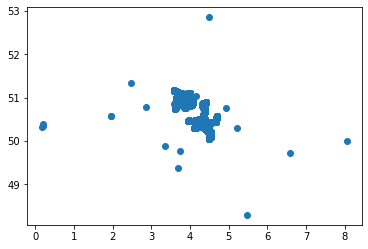

In [24]:
import matplotlib.pyplot as plt

# Chargez les données des trains
df = correlation_df

# Obtenez la latitude et la longitude des trains
latitude = df["Lat_x"]
longitude = df["Lon_x"]

# Créez la carte
plt.scatter(longitude, latitude)
plt.show()


In [67]:
test = merged_df[merged_df['Repair'] == 1]
test

,Unnamed: 0,Row_number,Mapped_veh_id,Dates,Time,Distance,Lat_x,Lon_x,Time_elapsed,Speed,...,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,Station,Round_time,Temperature,Rel_hum,Precipitation,Pressure,Repair
0,0,5493376,102.0,2023-01-23,07:25:08,NaN,51.017864,3.769079,0.0,NaN,...,80.0,71.0,79.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1
1,1,8969009,102.0,2023-01-23,07:25:16,0.000034,51.017875,3.769046,8.0,0.000015,...,80.0,76.0,79.0,06434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1
2,2,13873566,102.0,2023-01-23,07:25:37,0.001314,51.017208,3.770179,21.0,0.000225,...,81.0,79.0,81.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1
3,3,14994675,102.0,2023-01-23,07:25:41,0.000905,51.016916,3.771036,4.0,0.000815,...,81.0,79.0,81.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1
4,4,11935795,102.0,2023-01-23,07:26:10,0.001219,51.016503,3.772182,29.0,0.000151,...,82.0,79.0,79.0,6434,2023-01-23 07:00:00,1.5,96.0,0.0,1036.6,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1176527,1176527,861607,123.0,2023-06-08,02:08:37,0.001197,50.935961,5.310076,60.0,0.000072,...,59.0,54.0,54.0,NaN,NaN,NaN,NaN,NaN,NaN,1
1176528,1176528,1551506,123.0,2023-06-08,02:09:37,0.002793,50.936620,5.307362,60.0,0.000168,...,60.0,51.0,55.0,NaN,NaN,NaN,NaN,NaN,NaN,1
1176529,1176529,15755138,123.0,2023-06-08,02:10:38,0.000762,50.936810,5.306624,61.0,0.000045,...,60.0,54.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,1
1176530,1176530,10779814,123.0,2023-06-08,02:11:38,0.000080,50.936870,5.306676,60.0,0.000005,...,60.0,50.0,55.0,NaN,NaN,NaN,NaN,NaN,NaN,1
